# Air BnB Project Notebook 
---------
## Explores Rental Market in Seattle, New York & San Francisco Area

#### Contains 3 sub-notebooks merged into one:
1. Part A- Customer Sentiment Analysis
2. Part B- Network Analysis
3. Part C- Time Series Forecasting


#### Objective:
* Explore how customers feel staying with Air BnB? 

* Why Air Bnb is successful? 

* How much would be the average cost and availability next year? 

Using above exploration, develop features from this study such as sentiments score and centrality measures to use in the model.

#### Dataset: 
* Public Source: [Inside Air BnB](http://insideairbnb.com/get-the-data.html)
* To run the notebook, please refer to google drive links below:
    * [Part A and Part B](https://drive.google.com/drive/folders/1D5s0HkqLNU3fCHMxfM132sB5qbDyMZuQ?usp=sharing) 
    * [Part C](https://drive.google.com/drive/folders/1A-t_QZN-S3QrUiv5M7rFEGi9xhpW4Nx3?usp=sharing)
      * Part C uses output from Part A and B stored in pickle file format.  

#### Other notes: 
* All packages required to run this notebook are listed in the cell below. 
* System Requirements: [requirement.txt](https://drive.google.com/file/d/1rItfLCTA5942t_YIjbAnCwec8yQPnGbz/view?usp=sharing)
* Network graphs, particularly for New York city takes long time to run (approx ~18 minutes). Faster version currently in works. 

#### So, let's begin!


## 1. Part A-Explores Customer Sentiments of AirBnB Guests:
--------------------
In Seattle, Newyork and San Francisco area:

Tries to explore the question, are customers happy?
* Please click here [Part A and Part B](https://drive.google.com/drive/folders/1D5s0HkqLNU3fCHMxfM132sB5qbDyMZuQ?usp=sharing) to download the dataset.
* Requires detailed_reviews.csv file in each city to run this section.

In [1]:
# Load Packages

# Sentiments
import pandas as pd
import numpy as np
import re
import warnings
warnings.filterwarnings('ignore')
from tqdm import tqdm
tqdm.pandas()
import nltk
from stop_words import get_stop_words
from nltk.corpus import stopwords
from sklearn.preprocessing import StandardScaler
from collections import Counter
import matplotlib.pyplot as plt
%matplotlib inline
import cld2
import altair as alt
from altair_saver import save
import unicodedata

# Network
import networkx as nx
from functools import lru_cache
from networkx.drawing.nx_pydot import graphviz_layout
%config Completer.use_jedi = False                                  # patch required for my local machine
from operator import itemgetter
from nltk.util import flatten

# Time Series
import seaborn as sns
from prophet import Prophet

In [2]:
# enable correct rendering (unnecessary in later versions of Altair)
alt.renderers.enable('default')
# uses intermediate json files to speed things up
alt.data_transformers.enable('json')

DataTransformerRegistry.enable('json')

#### 1. Read files

In [3]:
# Read Reviews: 
san = pd.read_csv('../Dataset/Sanfrancisco/detailed_reviews.csv')
new = pd.read_csv('../Dataset/Newyork/detailed_reviews.csv')
sea = pd.read_csv('../Dataset/Seattle/detailed_reviews.csv')

# Add location name to each review
san['location']= 'sanfrancisco'
new['location'] = 'newyork'
sea['location'] = 'seattle'


In [4]:
# Concat reviews in seattle, new york and sanfrancisco:
df_rew = pd.concat([sea, new, san], axis= 0, ignore_index=True)

In [5]:
df_rew.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,location
0,2318,146,2008-09-15,2451,Kevin,1000 times better than staying at a hotel.,seattle
1,2318,126302712,2017-01-10,12332845,Jessica,"Our family (two couples, a two year old and an...",seattle
2,2318,140977084,2017-04-01,4789466,Ivan,Top of the list locations we have stayed at! T...,seattle
3,2318,147262504,2017-04-25,55817131,Mike,"SUCH an awesome place. Very clean, quiet and s...",seattle
4,2318,161806368,2017-06-18,113604590,Pete,We flew quite a distance to be at our only dau...,seattle


#### 2. Clean File: 

In [6]:
def remove_not_stopwords():
    
    """Return stopwords without negation"""
    
    # Get stopwords:
    stopword = list(stopwords.words('english'))
    
    # Get more stopwords: 
    stop_word = list(get_stop_words('en'))
    
    # Get all stop words:
    stop = stopword+stop_word
    
    # Remove negation from stopwords (n't)
    stop_clean = []
    for i in stop_word: 
        stop_clean.append(re.sub("(n't)", '', i))
    
    # Remove remaining negated stopwords 
    stop_neutral = [i for i in stop_clean if not i in ['but', 'ca', 'cannot','no', 'nor', 'not', 'sha', 'wo']]
    
    return stop_neutral

In [7]:
remove_not_stopwords()[:10]

['a', 'about', 'above', 'after', 'again', 'against', 'all', 'am', 'an', 'and']

In [8]:
from google_trans_new import google_translator  
#translator = google_translator() 
#detect = gcld3.NNetLanguageIdentifier(min_num_bytes=0, max_num_bytes=1000)

def normalize_text(df,text):
    """Normalizes text in to lower capital letters, removes non-alpha numeric characters,
        digits, new lines, stopwords from the original text"""
    
    stop_neutral = remove_not_stopwords()
    
    df['norm_comments'] = (df[text]
                .progress_apply(lambda x: str(x).lower())                                                                     #lower text
                .progress_apply(lambda z: re.sub('\n',"", z))                                                                 #remove new line
                .progress_apply(lambda s: [i for i in s.split() if not i in stop_neutral])                                    #remove stopwords
                .progress_apply(lambda j: " ".join(j))                                                                        #join text  
                .progress_apply(lambda y: re.sub('[\,\:\;\!\_\-\(\)\"\\/\.\d+]',"", y))                                       #remove non-alpha numeric characters except '', 
                .progress_apply(lambda e: ''.join([l for l in str(e) if unicodedata.category(l)[0] not in ('S', 'M', 'C')]))) #remove undesired utf-8 characters
    
    # detect language: en=1, all other languages 0
    df['lang_type'] = pd.DataFrame([cld2.detect(df['norm_comments'][i]) for i in range(0,len(df['norm_comments']))])['details'].progress_apply(lambda x: x[0][0].lower())
    
    # assign english=1, others= 0
    df['english'] = np.where(df['lang_type']=='english', 1, 0)
    
    return df

def convert_date(df): 
    """Converts date in to datetime object and gets year, month, week columns"""
    
    # Convert date to datetime: 
    df['date'] = pd.to_datetime(df['date'])
    df['month'] = df.date.dt.month
    df['year'] = df.date.dt.year
    df['week'] = df.date.dt.week
    
    return df

In [9]:
df_norm = normalize_text(df_rew, 'comments')
df_norm = convert_date(df_rew)

100%|██████████| 1357656/1357656 [00:01<00:00, 1124520.45it/s]


In [10]:
df_norm.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,location,norm_comments,lang_type,english,month,year,week
0,2318,146,2008-09-15,2451,Kevin,1000 times better than staying at a hotel.,seattle,times better staying hotel,english,1,9,2008,38
1,2318,126302712,2017-01-10,12332845,Jessica,"Our family (two couples, a two year old and an...",seattle,family two couples two year old infant incredi...,english,1,1,2017,2
2,2318,140977084,2017-04-01,4789466,Ivan,Top of the list locations we have stayed at! T...,seattle,top list locations stayed at house perfect fam...,english,1,4,2017,13
3,2318,147262504,2017-04-25,55817131,Mike,"SUCH an awesome place. Very clean, quiet and s...",seattle,awesome place clean quiet spacious loved it,english,1,4,2017,17
4,2318,161806368,2017-06-18,113604590,Pete,We flew quite a distance to be at our only dau...,seattle,flew quite distance daughter's graduation need...,english,1,6,2017,24


In [11]:
# See unique languages
df_norm['lang_type'].unique()

# Not all reviews are in english

array(['english', 'french', 'dutch', 'galician', 'unknown', 'chinese',
       'japanese', 'german', 'italian', 'spanish', 'swedish', 'chineset',
       'danish', 'korean', 'portuguese', 'norwegian', 'persian', 'polish',
       'russian', 'finnish', 'catalan', 'greek', 'scots_gaelic',
       'turkish', 'indonesian', 'thai', 'cebuano', 'hungarian', 'irish',
       'hebrew', 'kurdish', 'slovak', 'czech', 'arabic', 'vietnamese',
       'afrikaans', 'malagasy', 'serbian', 'icelandic', 'slovenian',
       'croatian', 'estonian', 'romanian', 'bosnian', 'swahili', 'hmong',
       'javanese', 'sesotho', 'ukrainian', 'basque', 'malay', 'uzbek',
       'ganda', 'kinyarwanda', 'sundanese'], dtype=object)

#### 3. Apply Sentiment analysis on unsupervised text: 

In [12]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
analyser = SentimentIntensityAnalyzer()

def sentiment(df, text):
    " Takes normalized text as datframe to estimate overall sentiment_polarity"
    
    # set sentiment: 
    df['scores'] = df[text].progress_apply(lambda x: analyser.polarity_scores(x))
    df['compound'] = df['scores'].progress_apply(lambda y: y['compound'])
    
    # assign rating (positive: >=0.05, negative: <=-0.05 , neutral: >-0.05 & < 0.05)
    df['rating'] = np.where(df['compound']>=0.05, 'positive', (np.where((df['compound']<0.05) & (df['compound']> -0.05), 'neutral', 'negative')))
        
    return df
        


In [13]:
df_senti = sentiment(df_norm, 'norm_comments')

100%|██████████| 1357656/1357656 [00:01<00:00, 1162273.29it/s]


In [14]:
df_senti['rating'].unique()

array(['positive', 'neutral', 'negative'], dtype=object)

In [15]:
df_senti.head(2)

,listing_id,id,date,reviewer_id,reviewer_name,comments,location,norm_comments,lang_type,english,month,year,week,scores,compound,rating
0,2318,146,2008-09-15,2451,Kevin,1000 times better than staying at a hotel.,seattle,times better staying hotel,english,1,9,2008,38,"{'neg': 0.0, 'neu': 0.508, 'pos': 0.492, 'comp...",0.4404,positive
1,2318,126302712,2017-01-10,12332845,Jessica,"Our family (two couples, a two year old and an...",seattle,family two couples two year old infant incredi...,english,1,1,2017,2,"{'neg': 0.033, 'neu': 0.607, 'pos': 0.36, 'com...",0.9974,positive


In [16]:
df_senti.location.value_counts()

newyork         821858
sanfrancisco    279937
seattle         255861
Name: location, dtype: int64

#### 4. Visualize Sentiments by Language & Year

In [17]:
def summarize_sentiments(df, col = 'lang_type'): 
    """Calculates % sentiment rating by column (language or year)"""
    
    # Count ratings: 
    count = df.groupby(['rating', col, 'english', 'location'])[col].count()
    
    # Total count of reviews:
    totalcount = df.groupby('location')[col].count()
    pct = count/totalcount
    
    df_senti_grp = pd.concat([count, pct], axis = 1, keys = ['count', 'pct']).reset_index()
    
    return df_senti_grp


In [18]:
summary_sentiments_lang = summarize_sentiments(df_senti, col = 'lang_type')
summary_sentiments_year = summarize_sentiments(df_senti, col = 'year')

In [19]:
display(summary_sentiments_lang.head(), summary_sentiments_year.head(), df_senti.head(2))

,rating,lang_type,english,location,count,pct
0,negative,afrikaans,0,newyork,1,0.000001
1,negative,catalan,0,newyork,33,0.000040
2,negative,catalan,0,sanfrancisco,6,0.000021
3,negative,catalan,0,seattle,1,0.000004
4,negative,chinese,0,newyork,4,0.000005


,rating,year,english,location,count,pct
0,negative,2009,0,newyork,1,0.000001
1,negative,2010,0,newyork,1,0.000001
2,negative,2010,0,sanfrancisco,1,0.000004
3,negative,2010,1,newyork,5,0.000006
4,negative,2010,1,sanfrancisco,2,0.000007


,listing_id,id,date,reviewer_id,reviewer_name,comments,location,norm_comments,lang_type,english,month,year,week,scores,compound,rating
0,2318,146,2008-09-15,2451,Kevin,1000 times better than staying at a hotel.,seattle,times better staying hotel,english,1,9,2008,38,"{'neg': 0.0, 'neu': 0.508, 'pos': 0.492, 'comp...",0.4404,positive
1,2318,126302712,2017-01-10,12332845,Jessica,"Our family (two couples, a two year old and an...",seattle,family two couples two year old infant incredi...,english,1,1,2017,2,"{'neg': 0.033, 'neu': 0.607, 'pos': 0.36, 'com...",0.9974,positive


In [20]:
def plot_sentiments(df1, df2, df3): 
    """Plot a bar graph showing % sentiments by Language and Year.
       Input : 1. summary_sentiments_lang 
               2. summary_sentiments_year
               3. df_senti
        Output: Plot of summary sentiments"""
    
    # Build radio button: 
    
    # get cities: 
    city = list(df3['location'].unique())
    
    # radio, name
    selectcity = alt.selection_single(fields=['location'],
                                      init={'location': city[0]},
                                      bind=alt.binding_radio(options=city, name = 'Select City'))
    
    # Sentiments by Language:
    sentiment_plot_lang = (alt.Chart(df1)
                     .mark_bar()
                     .encode(y=alt.Y('pct:Q', 
                                     stack= 'normalize',
                                     axis = alt.Axis(title = '% Sentiment Rating English vs Others',
                                     format= '%', labelColor= 'grey')),
                             x = alt.X('rating:N',
                                       axis = alt.Axis(title = 'Sentiments Rating')),
                             color = alt.Color('english:N', 
                                               sort= alt.EncodingSortField(field = 'english',order = 'descending'),
                                               scale = alt.Scale(scheme = 'cividis')),
                             tooltip= [alt.Tooltip('location:N', title = 'City'),
                                       alt.Tooltip('lang_type:N', title = 'Language Name'),
                                       alt.Tooltip('rating:N', title = 'Sentiment Type'),
                                       alt.Tooltip('pct:Q', title = 'Percent', format = '.2%'),
                                       alt.Tooltip('count:Q', title = 'Count of Records'),
                                       ])
                      .properties(width =320,
                                  height = 400,
                                  title = ['% Sentiment Rating by Language (Normalized)'])
                           .add_selection(selectcity).transform_filter(selectcity))
    
    # Sentiments by Year:  
    sentiment_plot_year = (alt.Chart(df2)
                     .mark_bar(opacity = 0.8)
                     .encode(y=alt.Y('pct:Q', 
                                     stack= 'zero',
                                     axis = alt.Axis(title = '% Sentiments Rating',
                                     format= '%', labelColor= 'grey')),
                             x = alt.X('year:O',
                                       axis = alt.Axis(title = 'Year')),
                             color = alt.Color('rating:N',
                                               sort= alt.EncodingSortField(field = 'rating', order = 'descending'),
                                               scale = alt.Scale(scheme = 'cividis')),
                             tooltip= [alt.Tooltip('location:N', title = 'City'),
                                       alt.Tooltip('year:O', title = 'Year'),
                                       alt.Tooltip('rating:N', title = 'Sentiment Type'),
                                       alt.Tooltip('pct:Q', title = 'Percent', format = '.2%'),
                                       alt.Tooltip('count:Q', title = 'Count of Records')],
                             size = alt.Size('pct:Q', scale = alt.Scale(range = [10,150])))
                      .properties(width =320,
                                  height = 400,
                                  title = ['% Sentiment Rating by Year',])
                           .add_selection(selectcity).transform_filter(selectcity))
    
    
    # Count operational months : 
    count_yearmonths_plot = (alt.Chart(df3.groupby(['year', 'location'])['month'].unique().apply(lambda x: len(x)).reset_index())
                    .mark_circle(color = 'red', opacity = 0.6)
                    .encode(x = alt.X('year:O', axis = None),
                            y= alt.Y('month:Q', axis = None),
                            size = alt.Size('month:Q', legend = alt.Legend(title = ["total months", "operated/year"], values = [4,8,12])), 
                            tooltip = [alt.Tooltip('month:Q', title = 'total months operated/year')])
                    .properties(width =320, height =20)
                             .add_selection(selectcity).transform_filter(selectcity))

    
    
    # Side-by-Side Plots:
    return ((sentiment_plot_lang | sentiment_plot_year & count_yearmonths_plot)
            .configure_view(strokeWidth =0)
            .configure(background = '#f0f0f0')
            .configure_view(strokeWidth =0)
            .configure_axis(grid = True)
            .resolve_scale(color='independent'))

In [21]:
# Final Plot: 
chart_sentiments = plot_sentiments(summary_sentiments_lang, summary_sentiments_year, df_senti)
chart_sentiments

alt.HConcatChart(...)

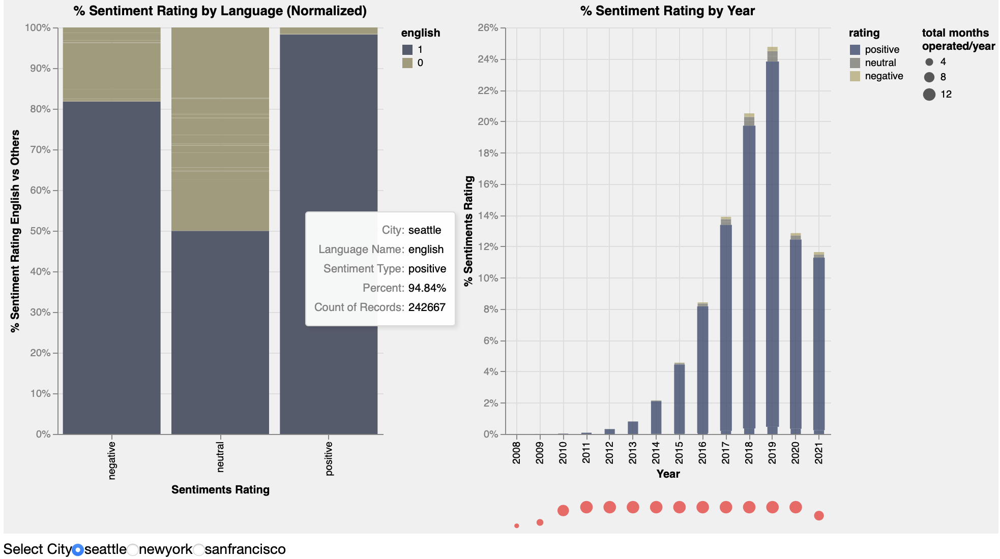

In [22]:
# Save sentiment features as csv file: 
df_senti.to_pickle('../Output/sentiment_feature.pkl')

#### Observations: 
1. Air BnB business operated between 2009 to 2021.
2. 2019 accounted for maximum reviews (>22% just before pandemic) compared to other years.
3. 2020 resulted in sudden decline in guest bookings due to pandemic.  
4. Negative reviews account for >2% among English and Foreign speakers. 
5. No data beyond April 2021. 
6. It's likely that positive sentiments have fueled business growth, but we cannot rule out the possibility of sample bias in the dataset. 

#### Other learnings: 
Below function gave us run time error, when we tried to translate other languages into English. However, this should work for smaller datasets. 

In [23]:
# Translate non-english sentences

def translate(df, text):
    " Resulted in 429 (too many requests error)"
    ind = df[text][(df['lang_type']!='english') & (df['lang_type']!='unknown')].index
    df[text] = df[text].loc[ind].progress_apply(lambda x: translator.translate(x))
    return df

## 2. Part B-Explores Network Relationships:
-------------------
Between popular/unpopular neighbourhoods, listing brokers, rental price, and customer sentiments in Seattle, Newyork and San Francisco using Network Graphs and Heatmap. 

Tries to explore the question, what might be the reason for business success? 

* Please click here [Part A and Part B](https://drive.google.com/drive/folders/1D5s0HkqLNU3fCHMxfM132sB5qbDyMZuQ?usp=sharing) to download the dataset.
* Requires detailed_listings.csv file in each city to run this section.

In [24]:
#Read file for Exploration

In [69]:
listings = pd.read_csv('../Dataset/Sanfrancisco/detailed_listings.csv')

In [70]:
# Any integer columns saved as an object: 
listings.select_dtypes(['object']).describe().columns
# Notice price column ('target') will require some cleaning
# Let's see price first:
listings['price']

0       $150.00
1       $195.00
2        $56.00
3        $56.00
4       $795.00
         ...   
6677    $135.00
6678     $55.00
6679    $188.00
6680    $126.00
6681    $120.00
Name: price, Length: 6682, dtype: object

In [27]:
import re
def build_network(file_listings, file_neighbourhoods, file_sentiments='sentiment_feature.pkl', source_column='neighbourhood_cleansed', target_column='host_name', popular_nodes= True): 
    """Returns a network graph of popular/unpopular nodes"""
    
    # Read and clean files:
    # read files: 
    df_lst = pd.read_csv('../Dataset/'+ file_listings)
    df_nei = pd.read_csv('../Dataset/'+ file_neighbourhoods)
    df_sent = pd.read_pickle('../Output/'+file_sentiments)

    #display(df_lst.head(2), df_nei.head(2))
    
    # convert file_neighbourhoods to a list: 
    lst_nei = df_nei['neighbourhood'].tolist()
    
    # filter file_listings by file_neighbourhoods: 
    df_listings_filter = df_lst[df_lst['neighbourhood_cleansed'].isin(lst_nei)].dropna(how='all')
    
    # merge customer sentiments:
    # groupby sentiments 
    df_sent_grp = df_sent.groupby('listing_id').agg({'compound':'mean'}).reset_index()
    df_filter = pd.merge(left = df_listings_filter, right = df_sent_grp, left_on = 'id', right_on = 'listing_id', how = 'inner').drop('listing_id', axis = 1)
    
    # clean and convert price column to float:
    df_filter['price'] = pd.to_numeric(df_filter['price'].str.split("$").str.get(1).progress_apply(lambda x: x.replace(',', '')))
    
    # Remove and, &, And, non-alphanumeric characters from host_name:
    df_filter['host_name'] = (df_filter['host_name']
                              .apply(lambda a: re.sub('(&)', ',', str(a)))
                              .apply(lambda b: re.sub('(and)',',', str(b)))
                              .apply(lambda c: re.sub('(And)',',', str(c)))
                              .apply(lambda d: re.sub('[\W+]',' ',str(d)))
                              .apply(lambda e: ' '.join([str(i) for i in e.split()])))
    
    
    # Build Network Graph: 
    G = nx.from_pandas_edgelist(df_filter, source=source_column, target=target_column, edge_attr= True)
    
    # Get unique nodes: 
    # source & target: 
    source_lsts = list(df_filter[source_column].unique())
    target_lsts = list(df_filter[target_column].unique())
    
    # Get node size:
    # source &  target
    source_size =  [G.degree(item)*60 for item in source_lsts]
    target_size = [G.degree(item)*60 for item in target_lsts]
     
    # Get top 5 nodes with highest degree:
    # source and target:
    top_5_sources = sorted([G.degree(item) for item in source_lsts], reverse = True)[:5][-1]
    top_5_targets = sorted([G.degree(item) for item in target_lsts], reverse = True)[:5][-1]
    
    low_5_sources = sorted([G.degree(item) for item in source_lsts], reverse = False)[:5][-1]
    low_5_targets = sorted([G.degree(item) for item in target_lsts], reverse = False)[:5][-1]
        
    # Plot Network:    
    _ = plt.figure(figsize=(27,27)) 
    _ = plt.title(f'Network Graph: {file_listings}\nPopular Nodes: {popular_nodes}', fontsize = 20)
    
    # layout:
    layout = nx.spring_layout(G, iterations=50, k= 0.1)
    
    # Draw Edges: 
    nx.draw_networkx_edges(G, layout, width=1, edge_color="lightgray")
    
    # Draw Target Nodes: 
    nx.draw_networkx_nodes(G, layout, nodelist=target_lsts, node_size= target_size, node_color='lightblue', edgecolors= 'gray')
    
    # Draw Source Nodes:
    nx.draw_networkx_nodes(G, layout, nodelist=source_lsts, node_size=source_size, node_color='gainsboro', edgecolors= 'gray')
    
    # Draw Popular Nodes:
    # filter popular nodes:
    if popular_nodes: 
        popular_sources = [item for item in source_lsts if G.degree(item)>=top_5_sources]
        popular_targets = [item for item in target_lsts if G.degree(item)>=top_5_targets]
        
        # draw popular source and target nodes:
        nx.draw_networkx_nodes(G, layout, nodelist=popular_sources, node_color='salmon', node_size=300, node_shape='D', label = f'Source: {source_column}')
        nx.draw_networkx_nodes(G, layout, nodelist=popular_targets, node_color='red', node_size=300, node_shape='D', label = f'Target: {target_column}')

        # Label nodes: 
        source_node_labels = dict(zip(popular_sources, popular_sources))
        target_node_labels = dict(zip(popular_targets, popular_targets))
        nx.draw_networkx_labels(G, layout, labels=source_node_labels, font_size= 9, horizontalalignment='left', verticalalignment= 'bottom')
        nx.draw_networkx_labels(G, layout, labels=target_node_labels, font_size= 9, horizontalalignment='right', verticalalignment = 'top')

        # 4. Turn off the axis 
        _ = plt.axis('off')
        _ = plt.legend(fontsize = 15)
        _ = plt.show()
    
    else: 
        unpopular_sources = [item for item in source_lsts if G.degree(item)<=low_5_sources]
        unpopular_targets = [item for item in target_lsts if ((G.degree(item)>low_5_targets+3) & (G.degree(item)<(low_5_targets)+5))]
        

        # draw popular source and target nodes:
        nx.draw_networkx_nodes(G, layout, nodelist=unpopular_sources, node_color='lightsalmon', node_size=300, node_shape='D', label = f'Source: {source_column}')
        nx.draw_networkx_nodes(G, layout, nodelist=unpopular_targets, node_color='mistyrose', node_size=300, node_shape='D', label = f'Target: {target_column}')

        # Label nodes: 
        source_node_labels_2 = dict(zip(unpopular_sources, unpopular_sources))
        target_node_labels_2 = dict(zip(unpopular_targets, unpopular_targets))
        nx.draw_networkx_labels(G, layout, labels=source_node_labels_2, font_size= 9, horizontalalignment='left', verticalalignment= 'bottom')
        nx.draw_networkx_labels(G, layout, labels=target_node_labels_2, font_size= 9, horizontalalignment='right', verticalalignment = 'top')

        # 4. Turn off the axis 
        _ = plt.axis('off')
        _ = plt.legend(fontsize = 15)
        _ = plt.show()
    return G
        

#### 1. Relationship between Neighborhood and Host
Seattle, Newyork, San Francisco: 

100%|██████████| 3333/3333 [00:00<00:00, 903250.97it/s]


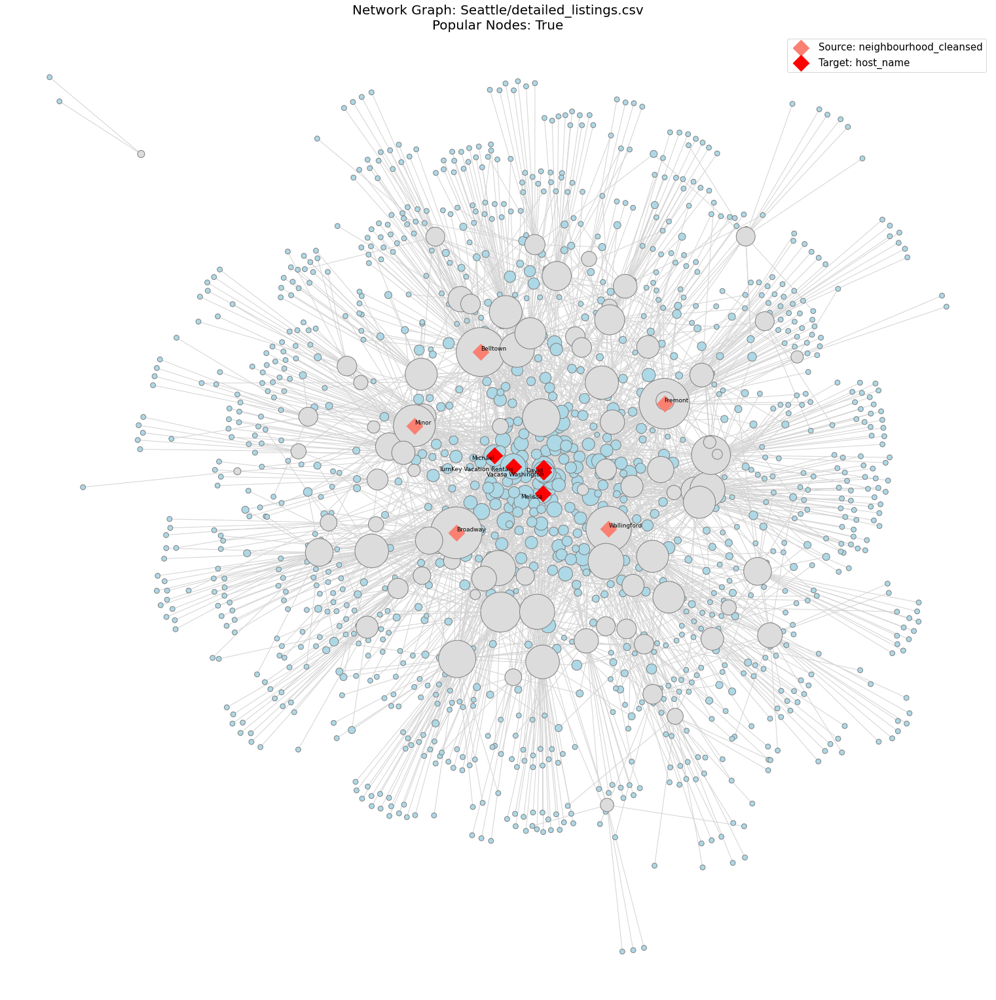

100%|██████████| 26772/26772 [00:00<00:00, 913527.66it/s]


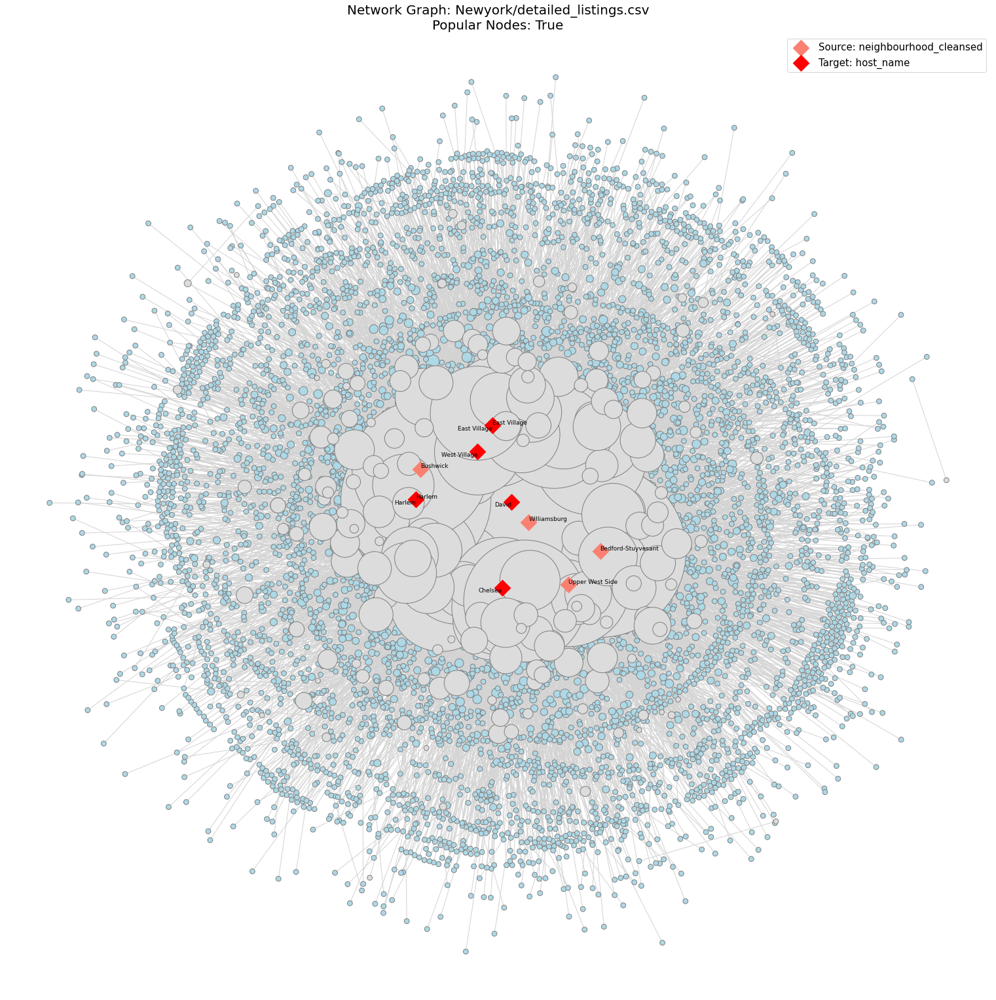

100%|██████████| 5010/5010 [00:00<00:00, 996796.31it/s]


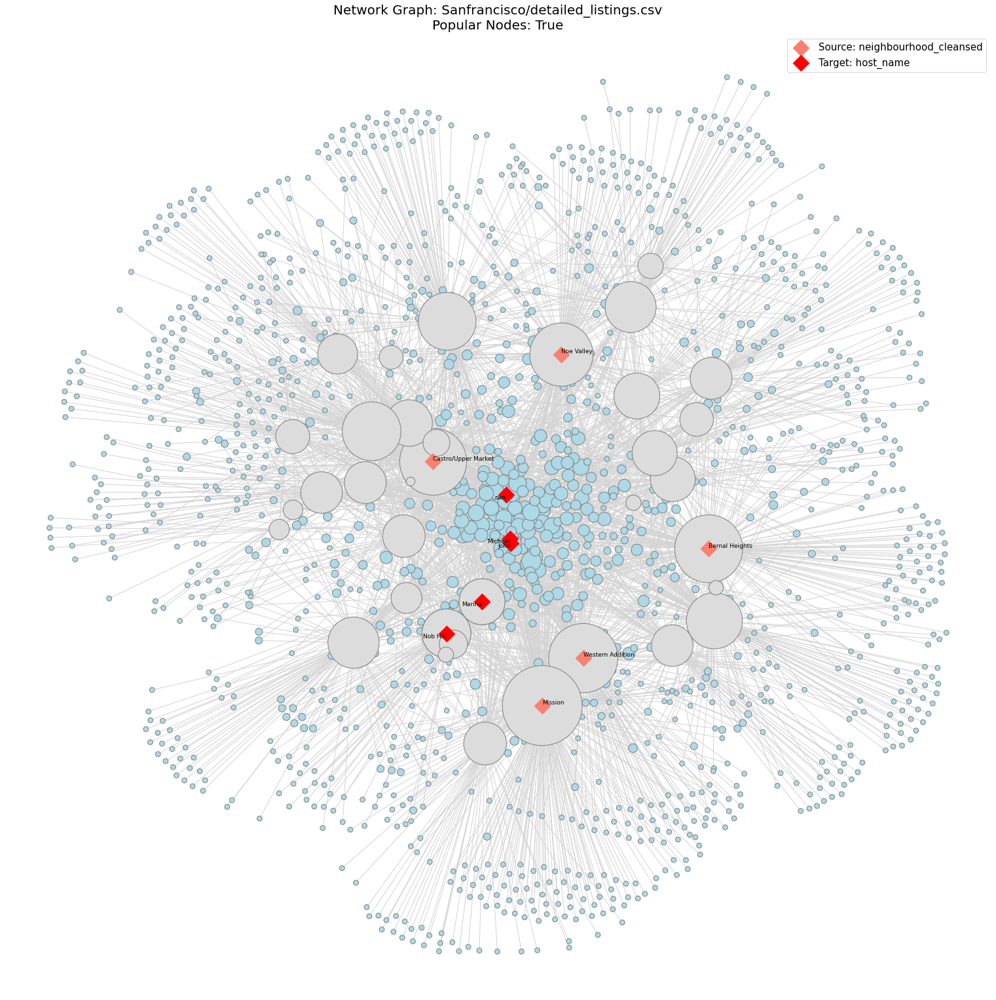

CPU times: user 2min 55s, sys: 2.16 s, total: 2min 57s
Wall time: 2min 40s


In [28]:
%%time 
G_host_sea = build_network('Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='host_name', popular_nodes= True)
G_host_new = build_network('Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='host_name', popular_nodes= True)
G_host_san = build_network('Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='host_name', popular_nodes= True)

# Assign name to the network: 
G_host_sea.name = 'Host_Names in Seattle'
G_host_new.name = 'Host_Names in Newyork'
G_host_san.name = 'Host_Names in Sanfrancisco'

#### 2. Hosts on shortest path in San Francisco ?

In [29]:
print(nx.shortest_path(G_host_san, 'Mission', 'David'))
print(nx.shortest_path(G_host_san, 'Crocker Amazon', 'David'))

['Mission', 'David']
['Crocker Amazon', 'Annie', 'Twin Peaks', 'David']


#### 3. Average shortest path of connected hosts in San Francisco?

In [30]:
largest_component = max(nx.connected_components(G_host_san), key = len)

print(nx.average_shortest_path_length(G_host_san.subgraph(largest_component)))

3.7117654621380582


#### 2. Relationship between Neighborhood and Price
Seattle, Newyork, San Francisco

100%|██████████| 3333/3333 [00:00<00:00, 908947.67it/s]


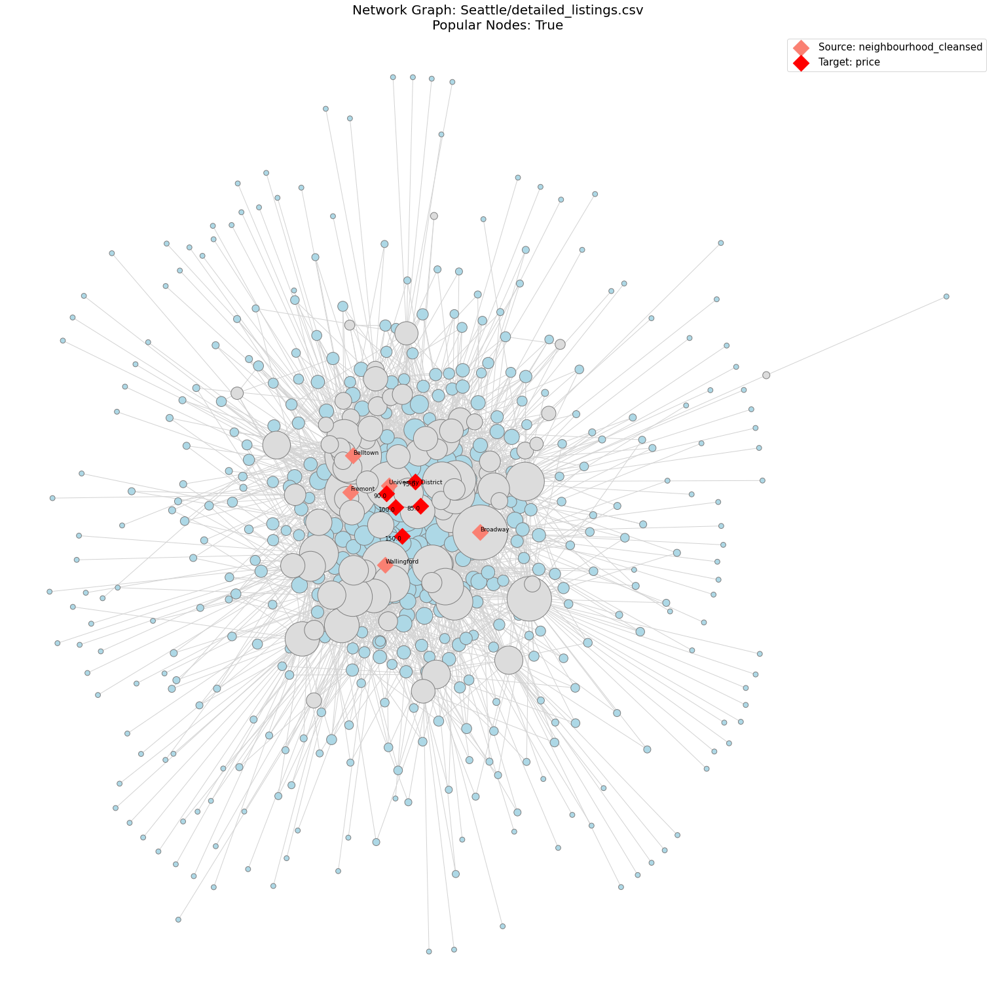

100%|██████████| 26772/26772 [00:00<00:00, 831278.32it/s]


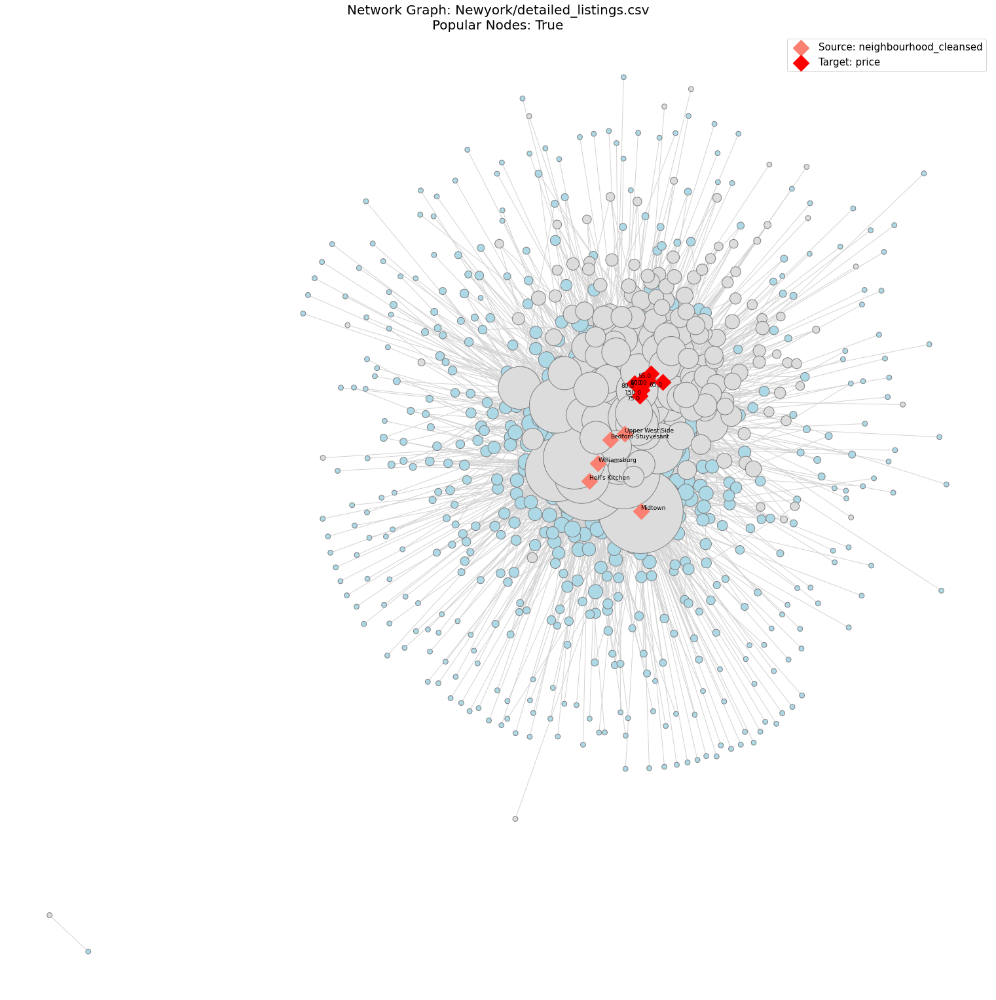

100%|██████████| 5010/5010 [00:00<00:00, 808210.12it/s]


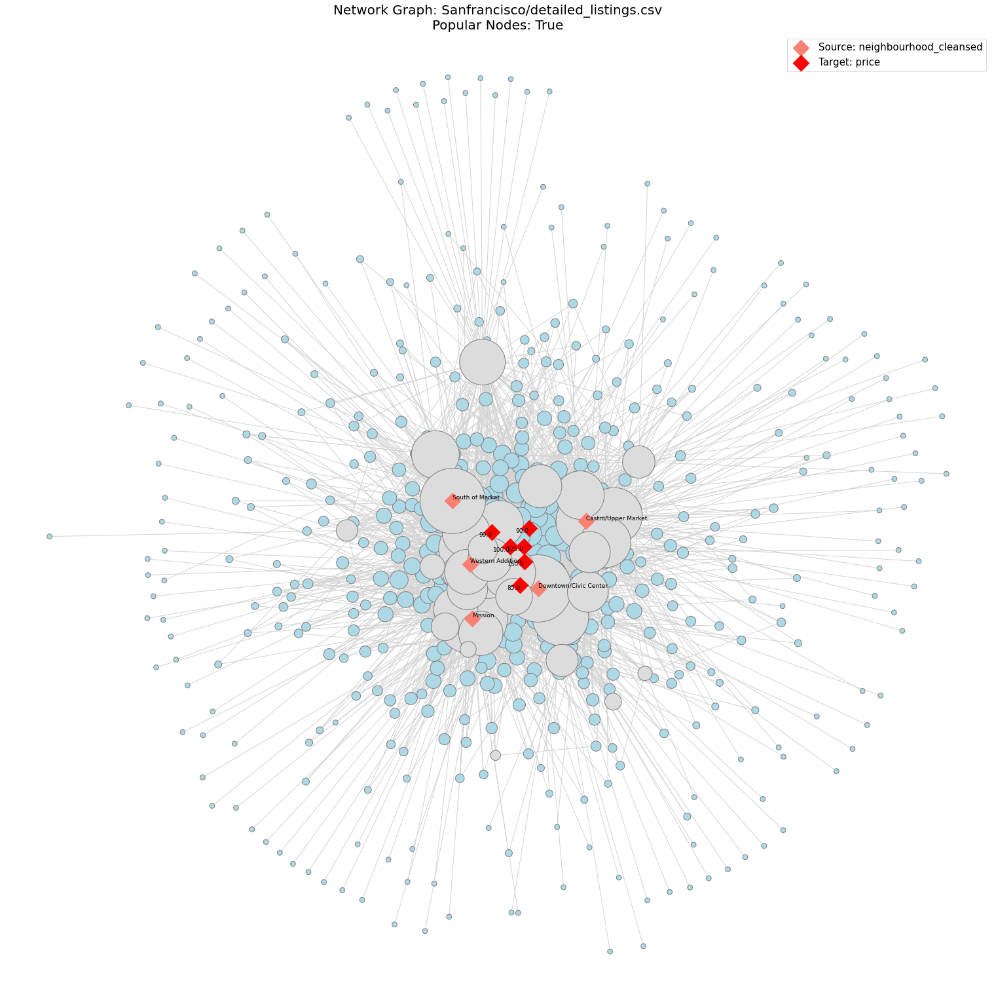

CPU times: user 17.9 s, sys: 1.06 s, total: 18.9 s
Wall time: 19.3 s


In [31]:
%%time 
G_price_sea = build_network('Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='price', popular_nodes= True)
G_price_new = build_network('Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='price', popular_nodes= True)
G_price_san = build_network('Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='price', popular_nodes= True)

# Assign name to the network: 
G_price_sea.name = 'Prices in Seattle'
G_price_new.name = 'Prices in Newyork'
G_price_san.name = 'Prices in Sanfrancisco'

#### 3. Relationship between Neighborhood and Rental Availability
Seattle, Newyork, San Francisco

100%|██████████| 3333/3333 [00:00<00:00, 692814.71it/s]


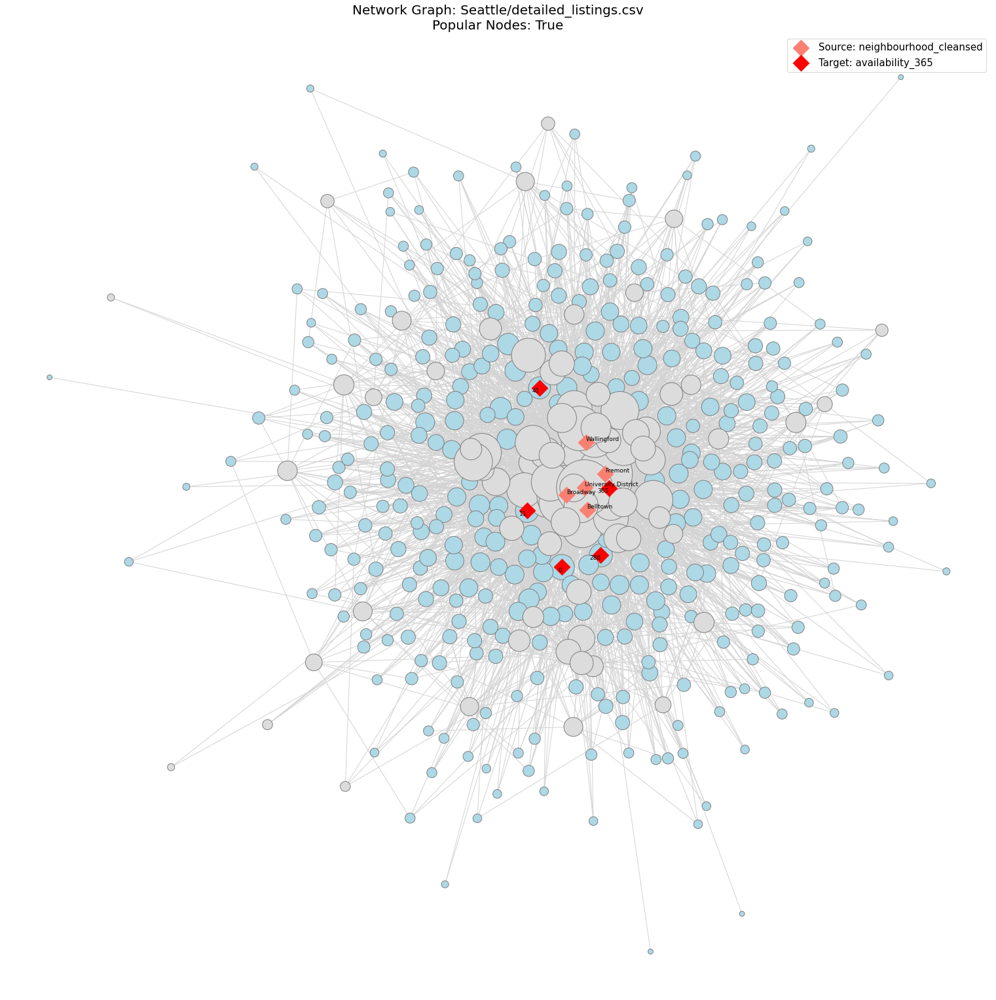

100%|██████████| 26772/26772 [00:00<00:00, 991014.82it/s]


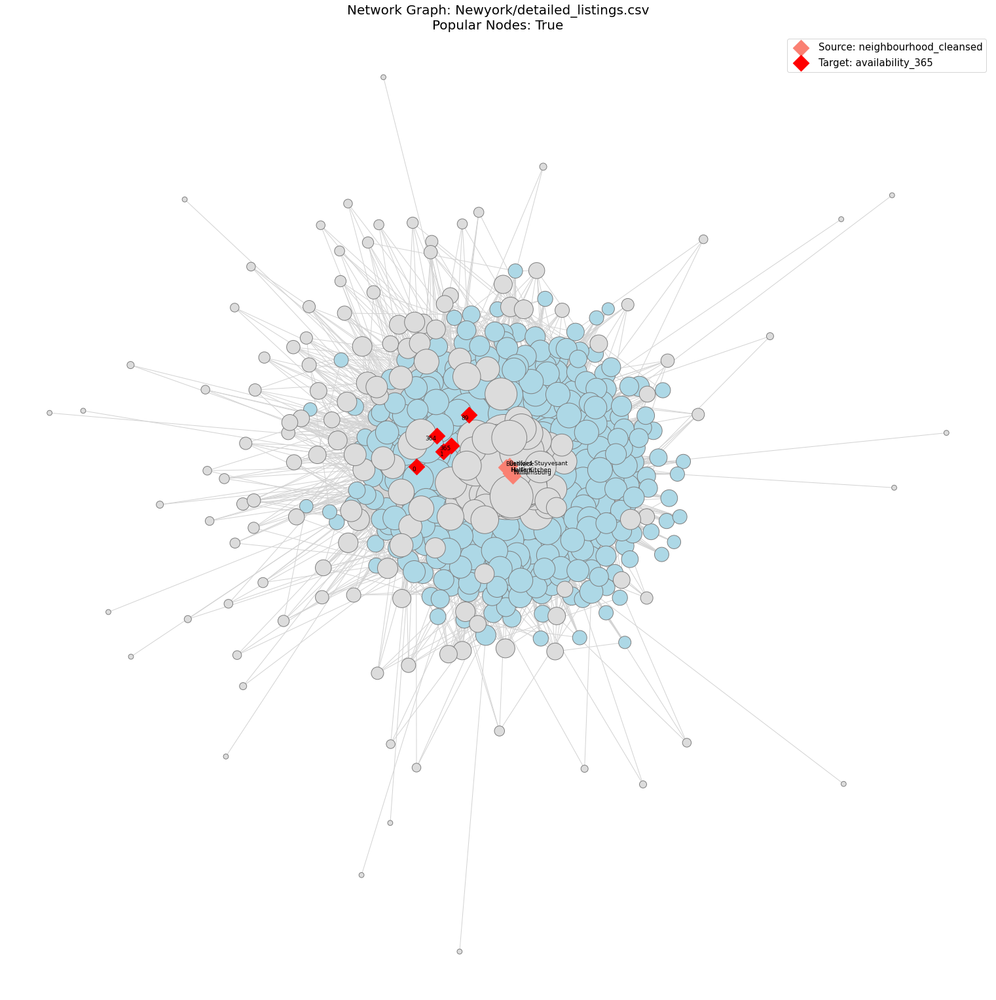

100%|██████████| 5010/5010 [00:00<00:00, 832612.05it/s]


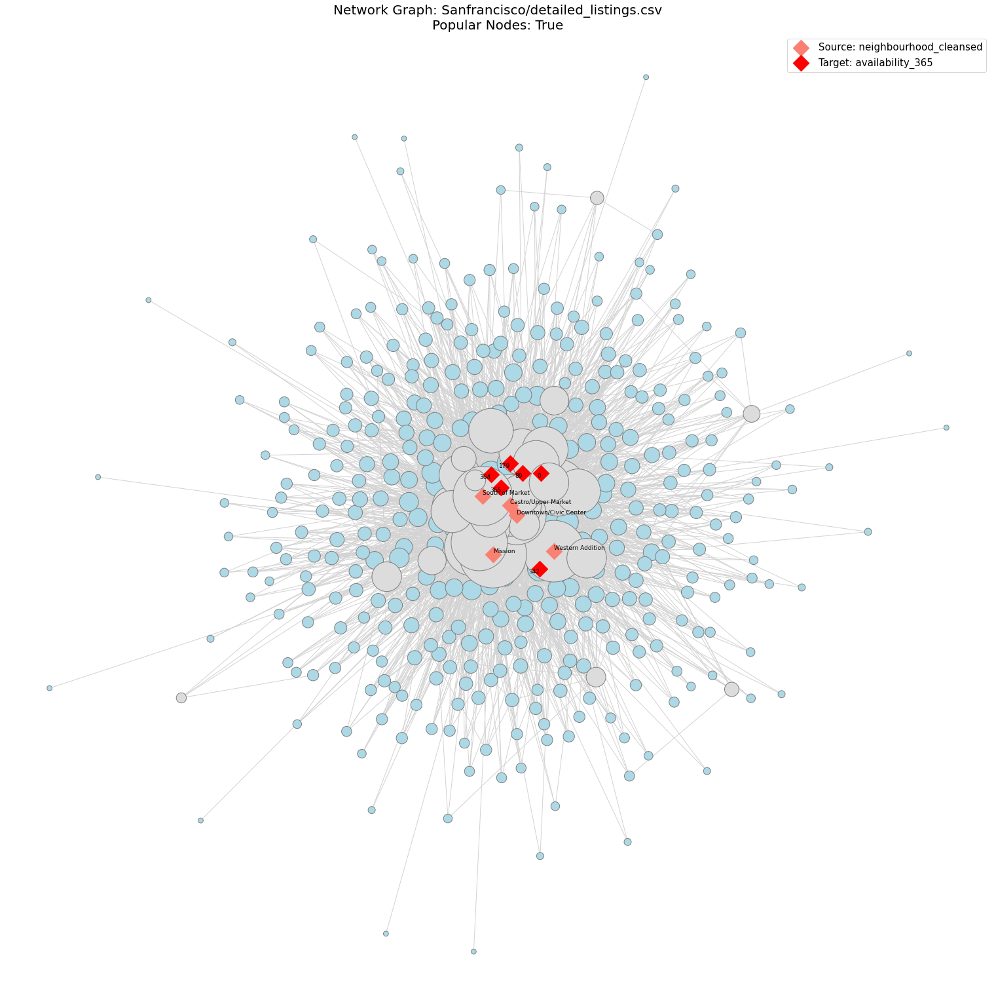

CPU times: user 11.9 s, sys: 989 ms, total: 12.9 s
Wall time: 13.1 s


In [32]:
%%time 
G_availability_sea = build_network('Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='availability_365', popular_nodes= True)
G_availability_new = build_network('Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='availability_365', popular_nodes= True)
G_availability_san = build_network('Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='availability_365', popular_nodes= True)

# Assign name to the network: 
G_availability_sea.name = 'Availability in Seattle'
G_availability_new.name = 'Availability in Newyork'
G_availability_san.name = 'Availability in Sanfrancisco'

#### 4. Relationship between Neighborhood and Customer Sentiments:
Seattle, Newyork, San Francisco

100%|██████████| 3333/3333 [00:00<00:00, 942022.59it/s]


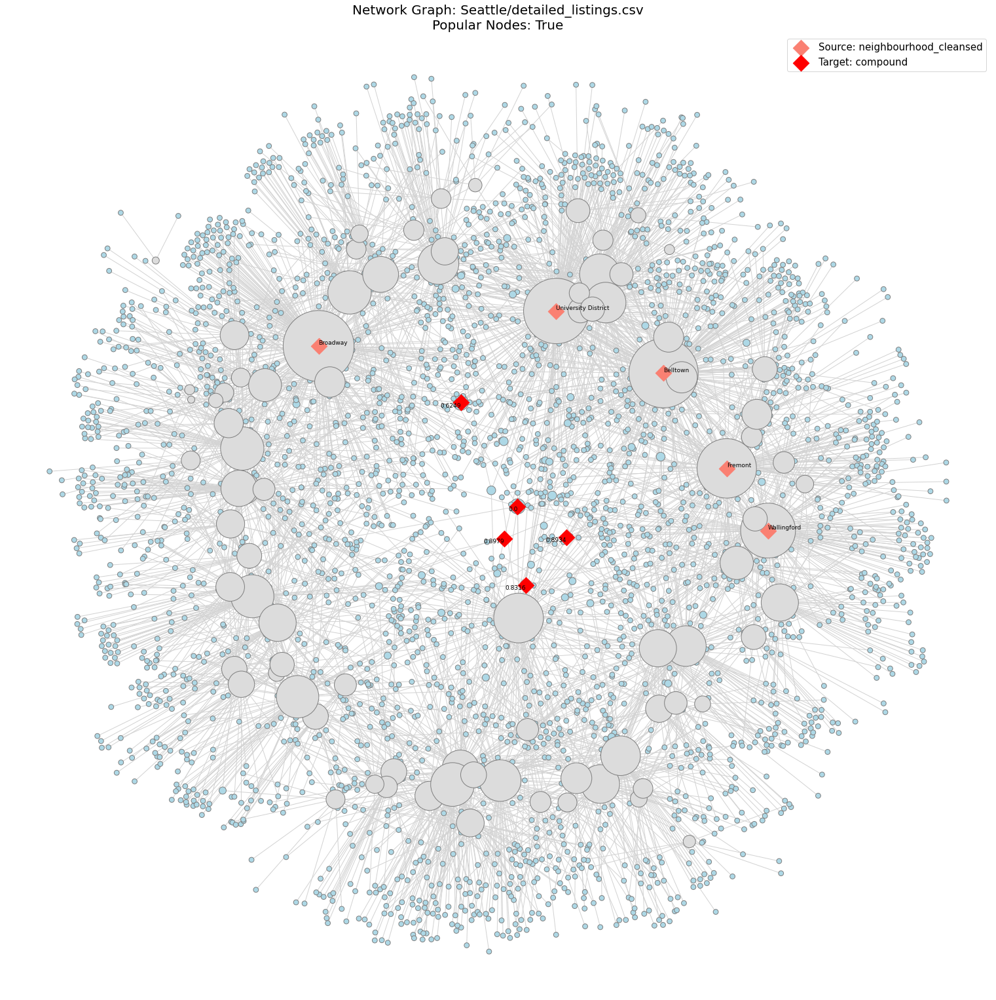

100%|██████████| 26772/26772 [00:00<00:00, 942709.56it/s]


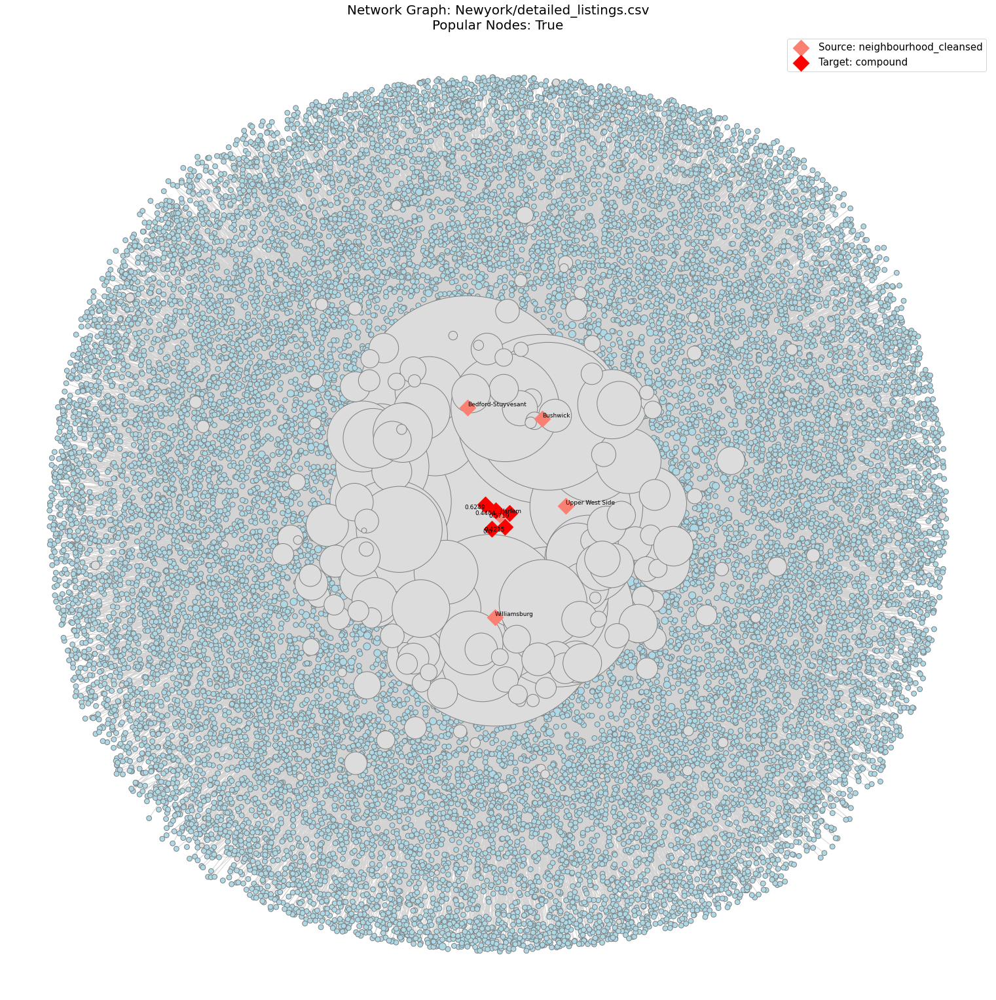

100%|██████████| 5010/5010 [00:00<00:00, 942772.80it/s]


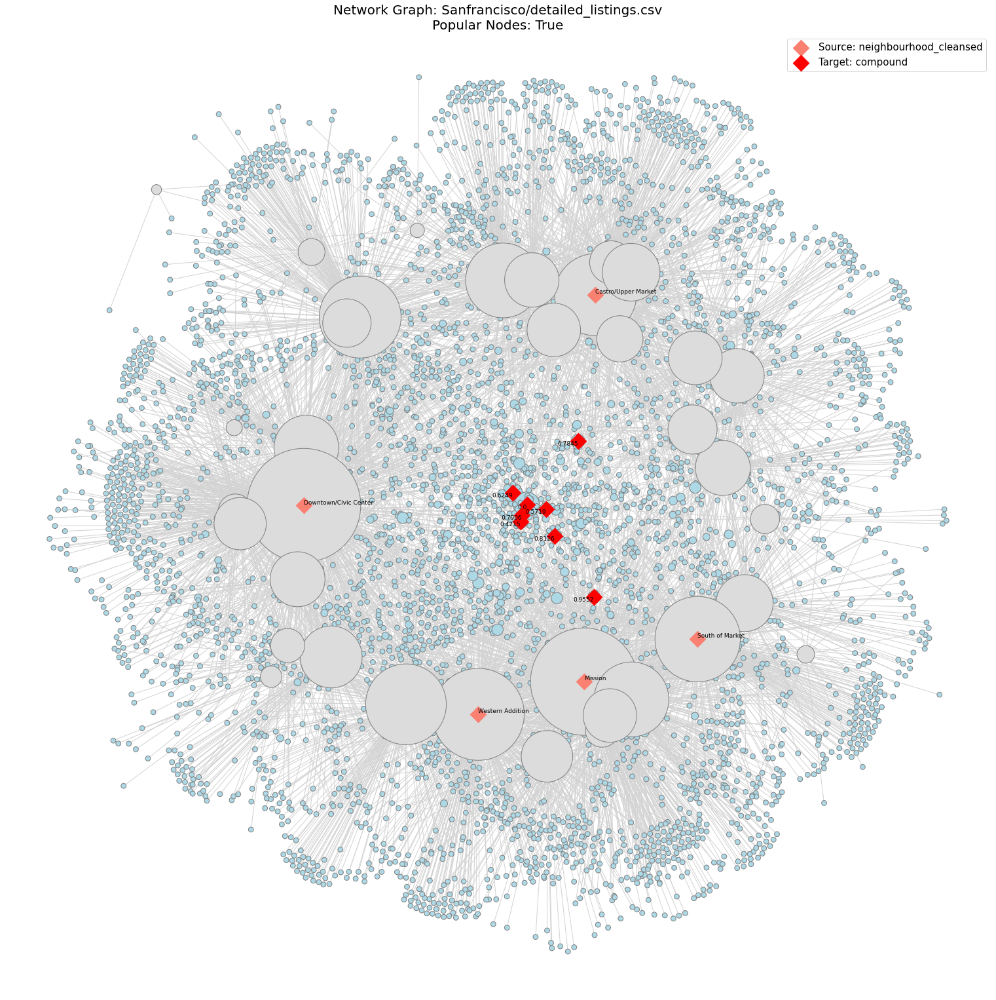

CPU times: user 17min 9s, sys: 4.66 s, total: 17min 14s
Wall time: 16min 12s


In [33]:
%%time 
G_sentiments_sea = build_network('Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='compound', popular_nodes= True)
G_sentiments_new = build_network('Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='compound', popular_nodes= True)
G_sentiments_san = build_network('Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv', source_column='neighbourhood_cleansed', target_column='compound', popular_nodes= True)

# Assign name to the network: 
G_sentiments_sea.name = 'Sentiments in Seattle'
G_sentiments_new.name = 'Sentiments in Newyork'
G_sentiments_san.name = 'Sentiments in Sanfrancisco'

#### 5. Centrality Measures

In [34]:
### Functions Centrality Measures:

def degree_centrality(G, top_n, popular= True): 
    """Returns degree centrality of popular and non-popular nodes"""
    
    # Centrality measure between Neighborhood and Host:
    deg_centrality = nx.degree_centrality(G)
    
    if popular:
        # Sorted in Descending Order: 
        df = pd.DataFrame(sorted(deg_centrality.items(), key = itemgetter(1), reverse = True)[:top_n], columns = ['Node', 'Degree Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    else: 
        df = pd.DataFrame(sorted(deg_centrality.items(), key = itemgetter(1), reverse = False)[:top_n], columns = ['Node', 'Degree Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    
    return df




def closeness_centrality(G, top_n, popular= True): 
    """Returns closeness centrality of popular and non-popular nodes"""
        
    # Centrality measure between Neighborhood and Host:
    close_centrality = nx.closeness_centrality(G)
    
    if popular:
        # Sorted in Descending Order:  
        df = pd.DataFrame(sorted(close_centrality.items(), key = itemgetter(1), reverse = True)[:top_n], columns = ['Node', 'Closeness Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    else: 
        df = pd.DataFrame(sorted(close_centrality.items(), key = itemgetter(1), reverse = False)[:top_n], columns = ['Node', 'Closeness Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    
    return df



def betweenness_centrality(G, top_n, popular= True): 
    """Returns betweenness centrality of popular and non-popular nodes"""
        
    # Centrality measure between Neighborhood and Host:
    between_centrality = nx.betweenness_centrality(G)
    
    if popular:    
        # Sorted in Descending Order: 
        df = pd.DataFrame(sorted(between_centrality.items(), key = itemgetter(1), reverse = True)[:top_n], columns = ['Node', 'Betweenness Centrality'], )
        df['Node'] = df['Node'].apply(lambda x: str(x))
    else: 
        df = pd.DataFrame(sorted(between_centrality.items(), key = itemgetter(1), reverse = False)[:top_n], columns = ['Node', 'Betweenness Centrality'])
        df['Node'] = df['Node'].apply(lambda x: str(x))
    
    return df

        
        
def result_centrality_measures(G, top_n, popular= True):
    """Returns 3 centrality measures of popular and non-popular nodes"""
    
    df_concat = pd.concat([degree_centrality(G, top_n, popular= popular),
                           closeness_centrality(G, top_n, popular= popular),
                           betweenness_centrality(G, top_n, popular= popular)])
    return pd.melt(id_vars='Node',
                   var_name='Centrality Measure',
                   value_name = 'Score',
                   frame = df_concat).dropna(how= 'any')



def plot_centrality_measure(G, top_n, popular=True): 
    """Returns a heat map of 3 centrality measures of popular and non-popular nodes"""    
    
    df = result_centrality_measures(G, top_n, popular=popular)
    
    nodes = df.sort_values(by = 'Score', ascending = False)
    sort_nodes = nodes['Node'].tolist()
    
    # plot chart: 
    line = (alt.Chart(df)
            .mark_line()
            .encode(x= alt.X('Node:N'),
                    y = alt.Y('Score:Q'),
                    color = alt.Color('Centrality Measure:N',legend = None))
            .transform_filter(alt.datum.Node!='nan'))
    
    line_points = (alt.Chart(df)
                   .mark_circle(size = 100)
                   .encode(x= alt.X('Node:N'),
                           y = alt.Y('Score:Q'), 
                           color = 'Centrality Measure:N',
                           size = alt.Size('Score:Q', scale = alt.Scale(range = (0,300))),
                   tooltip = ['Node:N', 'Centrality Measure:N', 'Score:Q'])
                   .transform_filter(alt.datum.Node!='nan'))
    
    rect = (alt.Chart(df)
            .mark_rect()
            .encode(x= alt.X('Centrality Measure:N'),
                    y = alt.Y('Node:N', sort =sort_nodes),
                    color = alt.Color('Score:Q'),
                    tooltip = ['Node:N', 'Centrality Measure:N', 'Score:Q'])
            .transform_filter(alt.datum.Node!='nan'))
    
    rect_circle = (alt.Chart(df)
              .mark_circle()
              .encode(x= alt.X('Centrality Measure:N'),
                      y = alt.Y('Node:N', sort = sort_nodes), 
                      size = alt.Size('Score:Q', scale = alt.Scale(range = (0,200))),
                      color = alt.Color('Score:Q', scale = alt.Scale(scheme = 'greys'), legend=None),
                      tooltip = ['Node:N', 'Centrality Measure:N', 'Score:Q'])
              .transform_filter(alt.datum.Node!='nan'))
    
    heatmap = (rect+rect_circle).resolve_scale(color='independent').properties(width = 300, height = 500)
    line_chart =(line+line_points).resolve_scale(color='independent').properties(width = 300, height = 500)

    
    return (heatmap|line_chart).properties(title = [f'Centrality Measure of top {top_n} nodes for {G.name}', f'Popular Nodes: {popular}'])


In [35]:
%%time
# Closeness Centrality: Helps spread information quickly
(plot_centrality_measure(G_host_sea, 10 , popular=True) 
 & plot_centrality_measure(G_host_new, 10 , popular=True) 
 & plot_centrality_measure(G_host_san, 10 , popular=True)) 

CPU times: user 6min 19s, sys: 436 ms, total: 6min 19s
Wall time: 6min 47s


alt.VConcatChart(...)

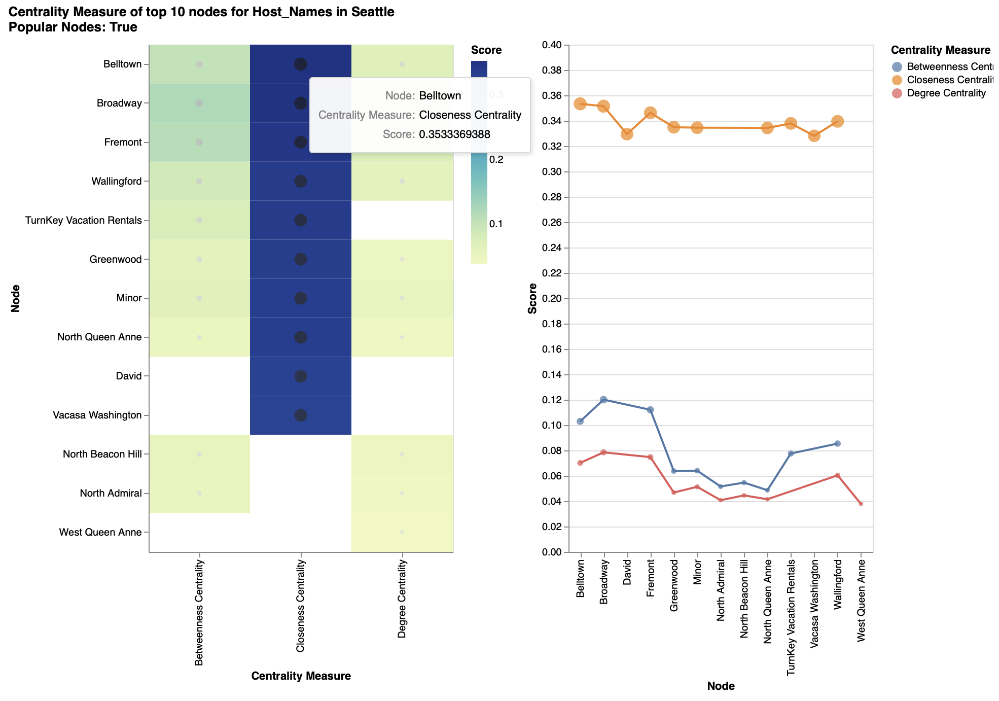

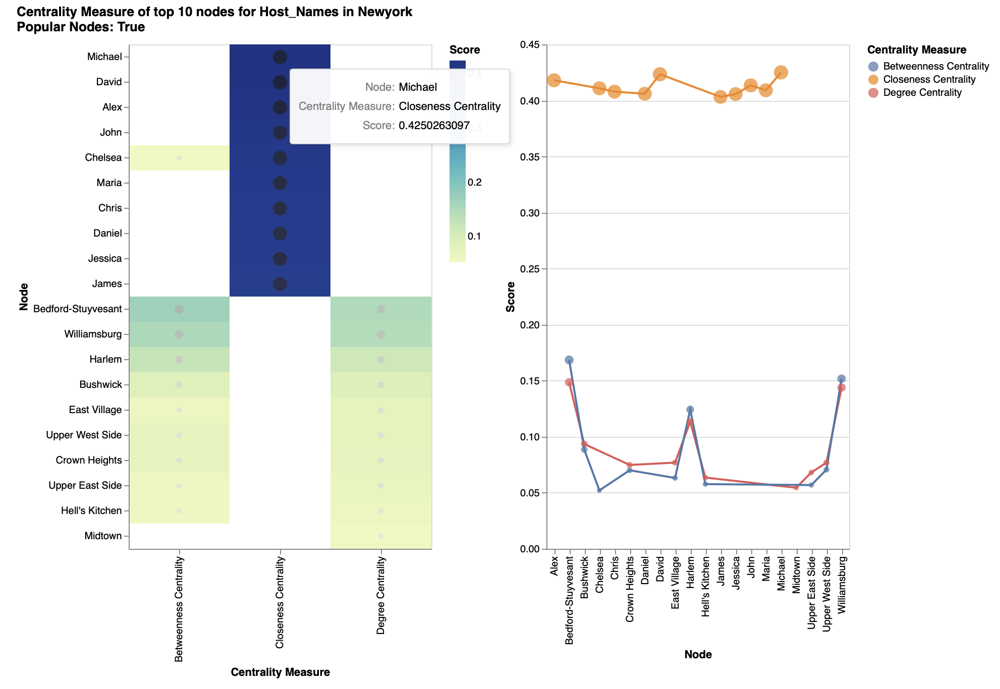

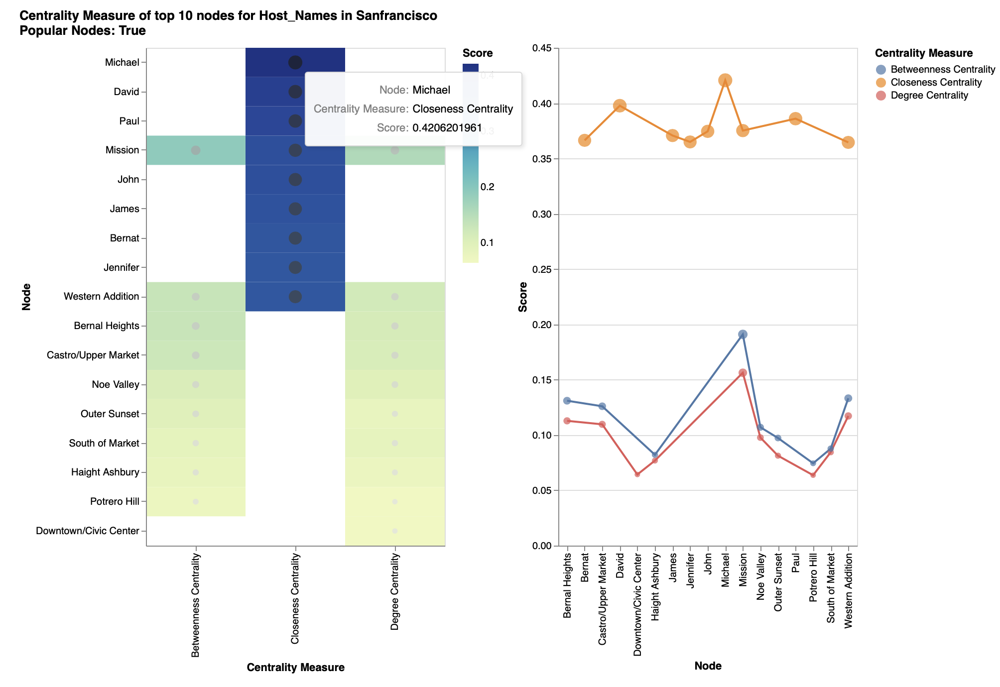

In [36]:
#Uncomment this to see popular prices in Seattle Area
plot_centrality_measure(G_price_sea, 10 , popular=True)

alt.HConcatChart(...)

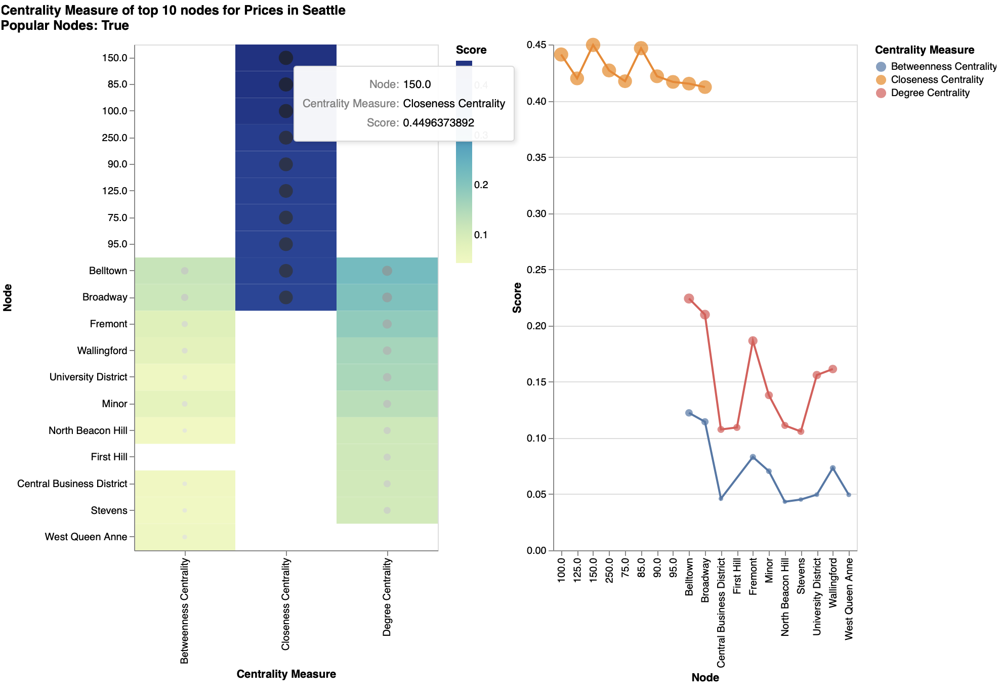

#### 5. Add Closesness Centrality as Network Feature: 

In [37]:
def add_centrality_measure(G, file_listings, file_neighbourhoods, file_sentiments = 'sentiment_feature.pkl'):
    
    """Returns dataframe with edge betweenness and closeness centrality """
    
    # Read and clean files:
    # read files: 
    df_lst = pd.read_csv('../Dataset/'+file_listings)
    df_nei = pd.read_csv('../Dataset/'+file_neighbourhoods)
    df_sent = pd.read_pickle('../Output/'+file_sentiments)
   
    #display(df_lst.head(2), df_nei.head(2))
    
    # convert file_neighbourhoods to a list: 
    lst_nei = df_nei['neighbourhood'].tolist()
    
    # filter file_listings by file_neighbourhoods: 
    df_listings_filter = df_lst[df_lst['neighbourhood_cleansed'].isin(lst_nei)].dropna(how='all')
    
    # merge customer sentiments:
    # groupby sentiments 
    df_sent_grp = df_sent.groupby('listing_id').agg({'compound':'mean'}).reset_index()
    df_filter = pd.merge(left = df_listings_filter, right = df_sent_grp, left_on = 'id', right_on = 'listing_id', how = 'inner').drop('listing_id', axis = 1)
    
    
    # clean and convert price column to float:
    df_filter['price'] = pd.to_numeric(df_filter['price'].str.split("$").str.get(1).progress_apply(lambda x: x.replace(',', '')))
    
    # replace and, &, And, + in host_name with commma:
    df_filter['host_name'] = (df_filter['host_name']
                              .apply(lambda a: re.sub('(&)', ',', str(a)))
                              .apply(lambda b: re.sub('(and)',',', str(b)))
                              .apply(lambda c: re.sub('(And)',',', str(c)))
                              .apply(lambda d: re.sub('[\W+]',' ',str(d)))
                              .apply(lambda e: ' '.join([str(i) for i in e.split()])))
    
    
    df_filter['node_edge']  = list(zip(df_filter['neighbourhood_cleansed'], df_filter['host_name']))
    
    edge_betweenness = nx.edge_betweenness_centrality(G)
    
    close_centrality = {i: nx.closeness_centrality(G, u = i[1]) for i in G.edges()}
    
    df_filter['edge_betweenness_host'] = df_filter['node_edge'].map(edge_betweenness)
    
    df_filter['closeness_centrality_host'] = df_filter['node_edge'].map(close_centrality)
   
    return df_filter

In [38]:
%%time
# Get centrality features for each city
network_feature_sea = add_centrality_measure( G_host_sea,'Seattle/detailed_listings.csv', 'Seattle/neighbourhoods.csv')
network_feature_new = add_centrality_measure(G_host_new,'Newyork/detailed_listings.csv', 'Newyork/neighbourhoods.csv')
network_feature_san = add_centrality_measure(G_host_san, 'Sanfrancisco/detailed_listings.csv', 'Sanfrancisco/neighbourhoods.csv')

100%|██████████| 5010/5010 [00:00<00:00, 944043.44it/s]


CPU times: user 9min 25s, sys: 2.97 s, total: 9min 28s
Wall time: 17min 35s


In [39]:
# Add location name to each listing
network_feature_sea['location']= 'seattle'
network_feature_new['location'] = 'newyork'
network_feature_san['location'] = 'sanfrancisco'

# Concat dataframe: 
df_network_feature = pd.concat([network_feature_sea, network_feature_new, network_feature_san], axis= 0, ignore_index=True)

# Save network_feature in output folder
df_network_feature.to_pickle('../Output/network_feature.pkl')

In [40]:
df_network_feature.head(3)

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,compound,node_edge,edge_betweenness_host,closeness_centrality_host,location
0,2318,https://www.airbnb.com/rooms/2318,20210714194849,2021-07-14,Casa Madrona - Urban Oasis 1 block from the park!,"Gorgeous, architect remodeled, Dutch Colonial ...",Madrona is a hidden gem of a neighborhood. It ...,https://a0.muscache.com/pictures/02973ad3-a7a3...,2536,https://www.airbnb.com/users/show/2536,...,2,2,0,0,0.58,0.880916,"(Madrona, Megan)",0.002049,0.281960,seattle
1,6606,https://www.airbnb.com/rooms/6606,20210714194849,2021-07-14,"Fab, private seattle urban cottage!","This tiny cottage is only 15x10, but it has ev...","A peaceful yet highly accessible neighborhood,...",https://a0.muscache.com/pictures/45742/21116d7...,14942,https://www.airbnb.com/users/show/14942,...,1,1,0,0,2.45,0.830917,"(Wallingford, Joyce)",0.001670,0.265394,seattle
2,9419,https://www.airbnb.com/rooms/9419,20210714194849,2021-07-14,Glorious sun room w/ memory foambed,"Keeping you safe is our priority, we are adher...","Lots of restaurants (see our guide book) bars,...",https://a0.muscache.com/pictures/56645186/e5fb...,30559,https://www.airbnb.com/users/show/30559,...,9,0,9,0,1.12,0.894111,"(Georgetown, Angielena)",0.000753,0.230757,seattle


#### 6. Relationship edge betweenness vs closeness centrality

In [41]:
def heatmap_network(df):
    
    """Returns a scatterplot between edge_betweenness and Closeness Centrality"""

    # unique locations:
    city = list(df['location'].unique())
    select = alt.selection_single(fields = ['location'], 
                                    init= {'location': city[0]},
                                    bind = alt.binding_radio(options = city, name= 'Select City'))


    closeness = (alt.Chart(df_network_feature)
                 .mark_bar()
                 .encode(y = alt.Y('closeness_centrality_host:Q'),
                         x= alt.X('location:N', axis = alt.Axis(title= "")),
                         color = alt.Color('location:N', scale=alt.Scale(scheme='viridis')),
                         tooltip = ['location:N', 'closeness_centrality_host:Q'])
                 .properties(width = 300, height = 400, title='Closeness Centrality Host')
                 .add_selection(select)
                   .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                           opacity = alt.condition(select, alt.value(1), alt.value(0.5))))

    edge_btw = (alt.Chart(df_network_feature)
                .mark_bar()
                .encode(y = alt.Y('edge_betweenness_host:Q'),
                        x= alt.X('location:N', axis = alt.Axis(title= "")), 
                        color = alt.Color('location:N', scale=alt.Scale(scheme='viridis')), 
                        tooltip = ['location:N', 'edge_betweenness_host:Q'])
                .properties(width = 300, height = 400, title='Edge Betweenness Host')
                .add_selection(select)
                   .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                           opacity = alt.condition(select, alt.value(1), alt.value(0.5))))

    edge_close = (alt.Chart(df_network_feature)
                  .mark_circle()
                  .encode(y = alt.Y('closeness_centrality_host:Q'),
                          x= alt.X('edge_betweenness_host:Q'),
                          color = alt.Color('location:N', scale=alt.Scale(scheme='viridis')), 
                          tooltip = ['location:N', 'closeness_centrality_host:Q', 'edge_betweenness_host:Q' ])
                  .properties(width = 700, height = 400, title='Edge Betweenness & Closeness Centrality')
                  .add_selection(select)
                   .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                           opacity = alt.condition(select, alt.value(1), alt.value(0.5))))


    return (((closeness|edge_btw) & edge_close)
     .configure_view(strokeWidth =0)
     .configure(background = '#f0f0f0')
     .configure_view(strokeWidth =0)
     .configure_axis(grid = True)
     .resolve_scale(color='independent'))


In [42]:
heatmap_network(df_network_feature)

alt.VConcatChart(...)

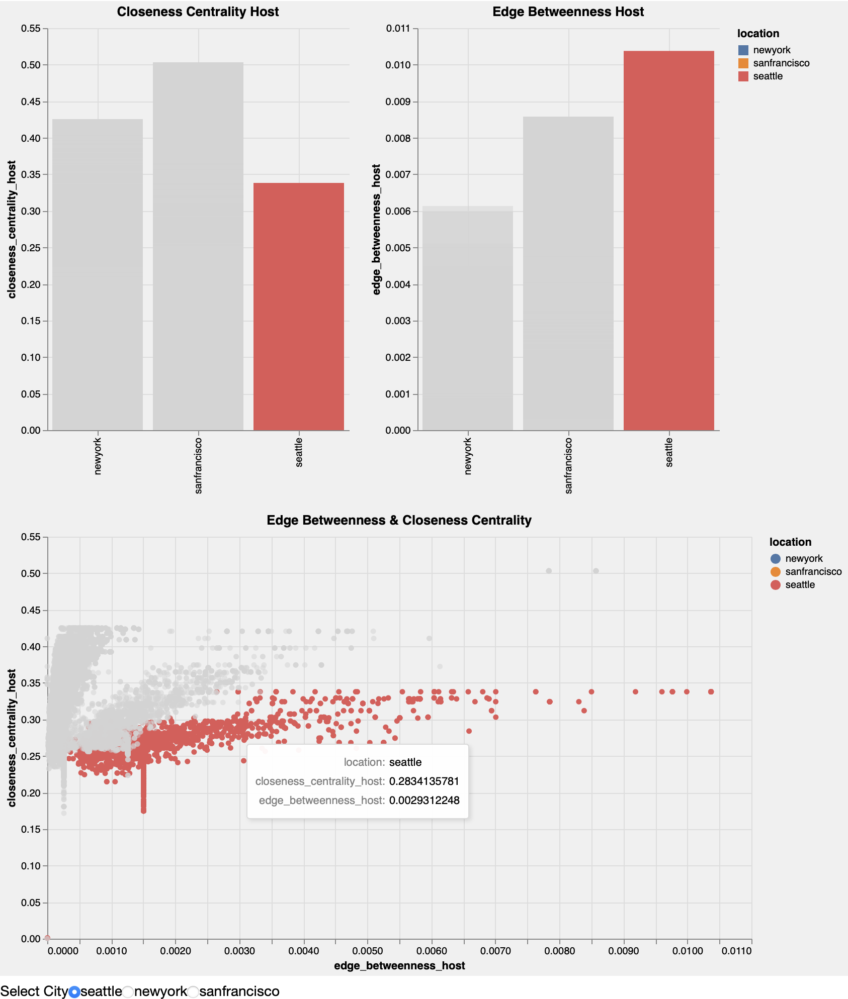

#### Observations: 

1. Shortest_path between neighbourhoods and popular hosts can be useful to run marketing campaigns in less popular neighbourhoods. 
2. As price increases, number of degree nodes between popular neighbourhoods and price also decreases.
3. Some neighbourhoods (popular vs upcoming) show high availability (>300 days). This could be due to high variance in rental pricing and length of stay.
(Example: Downtown area may see daily commuters more often than community based rentals. So, higher price community rentals will likely have higher availability) 
4. Heatmap can be used to view centrality measures and filter network by price, availability, customer sentiments and so on. 
5. Relationship between individual vs community brokers showed mixed customer sentiments.
(Example, individual brokers who had fewer (1 to 4) listings showed high positive sentiments. Also, few property managers (between 100 to 300 listings) showed high positive sentiments when compared to property managers with more listings.)   
6. Above can be useful in exploring neighbourhoods or brokers with lower customer sentiments for empowerment. 
5. Edge Centrality and Closeness Centrality shows linearly positive correlation for all 3 cities. This could mean that AirBnB might be using community brokers or superhosts to build highly close knit neighbourhoods in these areas. 


## 3. Part C-Explores Time Series Forecasting:
___________________________
In Seattle, New York and San Francisco listings for the next one year. 

Tries to explore the question, what's the average price and availability by month? 

* Please click here [Part C](https://drive.google.com/drive/folders/1A-t_QZN-S3QrUiv5M7rFEGi9xhpW4Nx3?usp=sharing) to download the dataset
* Requires both sentiment_feature.pkl and network_feature.pkl files to run this section. 

In [43]:
# Read files for exploration 

In [44]:
sentiment = pd.read_pickle('../Output/sentiment_feature.pkl')
network = pd.read_pickle('../Output/network_feature.pkl')

In [45]:
display(sentiment.head(2), network.head(2))

,listing_id,id,date,reviewer_id,reviewer_name,comments,location,norm_comments,lang_type,english,month,year,week,scores,compound,rating
0,2318,146,2008-09-15,2451,Kevin,1000 times better than staying at a hotel.,seattle,times better staying hotel,english,1,9,2008,38,"{'neg': 0.0, 'neu': 0.508, 'pos': 0.492, 'comp...",0.4404,positive
1,2318,126302712,2017-01-10,12332845,Jessica,"Our family (two couples, a two year old and an...",seattle,family two couples two year old infant incredi...,english,1,1,2017,2,"{'neg': 0.033, 'neu': 0.607, 'pos': 0.36, 'com...",0.9974,positive


,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,compound,node_edge,edge_betweenness_host,closeness_centrality_host,location
0,2318,https://www.airbnb.com/rooms/2318,20210714194849,2021-07-14,Casa Madrona - Urban Oasis 1 block from the park!,"Gorgeous, architect remodeled, Dutch Colonial ...",Madrona is a hidden gem of a neighborhood. It ...,https://a0.muscache.com/pictures/02973ad3-a7a3...,2536,https://www.airbnb.com/users/show/2536,...,2,2,0,0,0.58,0.880916,"(Madrona, Megan)",0.002049,0.281960,seattle
1,6606,https://www.airbnb.com/rooms/6606,20210714194849,2021-07-14,"Fab, private seattle urban cottage!","This tiny cottage is only 15x10, but it has ev...","A peaceful yet highly accessible neighborhood,...",https://a0.muscache.com/pictures/45742/21116d7...,14942,https://www.airbnb.com/users/show/14942,...,1,1,0,0,2.45,0.830917,"(Wallingford, Joyce)",0.001670,0.265394,seattle


#### 1. Get Merged File

In [46]:
def read_merge_file(file1_pkl, file2_pkl):
    
    """Returns a merged dataframe of Sentiment and Network Analysis for Time Series Forecatsing"""
    
    # read files:
    df1 = pd.read_pickle('../Output/'+file1_pkl)
    df2 = pd.read_pickle('../Output/'+file2_pkl)
    
    # use columns: 
    df1_cols = ['listing_id', 'date', 'comments', 'compound', 'rating']
    
    df2_cols = ['id', 'name', 'price', 'availability_365', 'location']
    
    # merge df's
    df = pd.merge(left = df1[df1_cols], right = df2[df2_cols], left_on = 'listing_id', right_on = 'id', how = 'inner')
    
    return df
    
    

#### 2. Plot a boxplot for possible outliers in price and availability

In [47]:
df_merge = read_merge_file('sentiment_feature.pkl', 'network_feature.pkl')

def plot_boxplot(col1, col2):
    """Returns a box plot of price and availability indicating presence of possibile outliers """
    fig, ax= plt.subplots(1,2, figsize =(20,10))
    sns.boxplot(data = df_merge, x = 'location', y = col1, hue = 'location', fliersize=5, palette = 'inferno',ax = ax[0], width = 1)
    _ = ax[0].set_title('Price Boxplot', fontsize = 15)
    sns.boxplot(data = df_merge, x = 'location', y = col2, hue = 'location', fliersize=5, palette = 'inferno',ax = ax[1])
    _ = ax[1].set_title('Availability Boxplot', fontsize = 15)
    _ = ax[1].legend(loc= 'upper right')


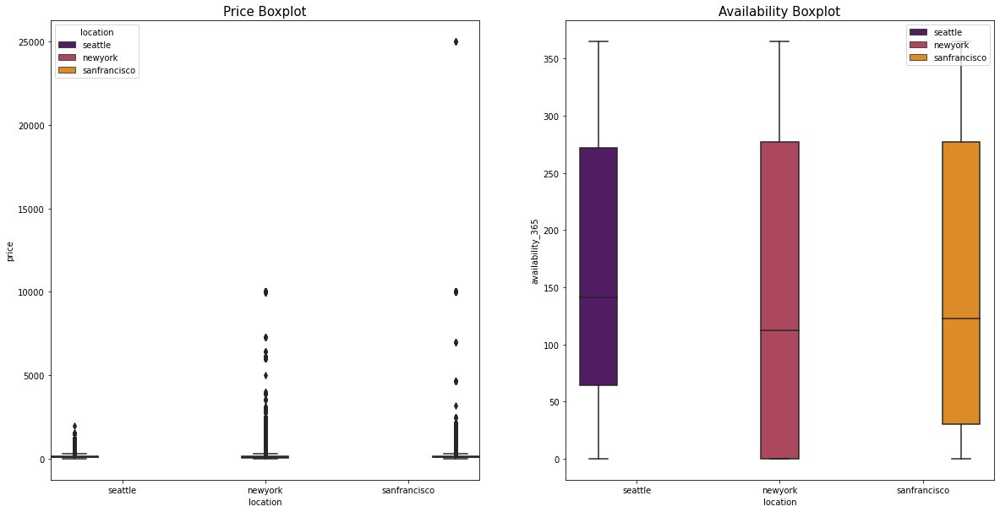

In [48]:
plot_boxplot('price', 'availability_365')

In [49]:
# View outliers
# View property; price > $20000/day
df_merge[['name', 'comments', 'date']][df_merge['price']>=20000]

,name,comments,date
1352136,"Harbor Court Hotel, Bay View Queen Room",Cute hotel with wonderful views of the Bay Bri...,2019-11-17
1352137,"Harbor Court Hotel, Bay View Queen Room",Very cute place and great view of bridge,2019-12-29
1352138,"Harbor Court Hotel, Bay View Queen Room",Had a fantastic stay at the harbor court! Clos...,2020-02-08


#### 3. Time Series Exploration

In [72]:
def get_annualbooking_counts(df): 
    """Returns a new column booking_counts by grouping data on date and price"""
    
    # mean price by date and location:
    df['booking_counts'] = df.groupby(['date', 'location'])['price'].transform('count')
    
    return df
     

#### 4. Plot Time Series Exploration

In [73]:
def timeseries_plot(df, top_bookings):
    """Takes mean and count of various time series features grouped by date and location to build an exploration plot"""
    
    # Prepare time series data
    
    # mean price
    mean_price = df.groupby(['date', 'location'])['price'].mean().reset_index()
    mean_price['price']= mean_price['price'].round(2)
    
    # mean availability:
    mean_availablity = df.groupby(['date', 'location'])['availability_365'].mean().reset_index()
    mean_availablity['availability_365']= mean_availablity['availability_365']
    
    # count bookings:
    df_count = get_annualbooking_counts(df)
    count_bookings = df_count.groupby(['date', 'location'])['booking_counts'].count().reset_index()
    
    most_bookings = df_count.groupby(['name', 'price','location']).agg({'booking_counts':'count'}).sort_values(by ='booking_counts', ascending=False)
    
    
    # Create filter
    # unique locations:
    city = list(df['location'].unique())
    select = alt.selection_single(fields = ['location'], 
                                  init= {'location': city[0]},
                                  bind = alt.binding_radio(options = city, name= 'Select City'))
    
    # Price Chart
    price_chart = (alt.Chart(mean_price)
                   .mark_line()
                   .encode(x = alt.X('date:T', axis = alt.Axis(title = "")),
                           y = alt.Y('price:Q'),
                           color = 'location:N',
                           tooltip= ['location:N', 'price:Q', 'date:T'])
                   .properties(width = 350, height= 150, title = "Average Price")
                   .add_selection(select)
                   .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                           opacity = alt.condition(select, alt.value(1), alt.value(0.5))))
    
    # Availability Chart
    availability_chart = (alt.Chart(mean_availablity)
                   .mark_line()
                   .encode(x = alt.X('date:T', axis = alt.Axis(title = "")),
                           y = alt.Y('availability_365:Q'),
                           color = 'location:N',
                           tooltip= ['location:N', 'availability_365:Q', 'date:T'])
                   .properties(width = 350, height= 150, title = "Average Availability_365")
                   .add_selection(select)
                   .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                           opacity = alt.condition(select, alt.value(1), alt.value(0.5))))    
    

  
    # Count Chart
    booking_chart = (alt.Chart(count_bookings)
                    .mark_line()
                    .encode(x = alt.X('date:T'),
                            y = alt.Y('booking_counts:Q'),
                            color = 'location:N',
                            tooltip= ['location:N', 'booking_counts:Q', 'date:T'])
                    .properties(width = 350, height= 150, title = 'Annual Booking Counts').add_selection(select)
                    .encode(color = alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                            opacity = alt.condition(select, alt.value(1), alt.value(0.5))))    
    
    
   
    mostbookings_chart = (alt.Chart(most_bookings.reset_index()[:top_bookings])
                    .mark_bar()
                    .encode(x = alt.X('name:N', axis = alt.Axis(labelAngle= -45, title = "")),
                            y = alt.Y('booking_counts:Q', axis = alt.Axis(title = 'Count Most Bookings')),
                            color = alt.Color('location', legend = False),
                            tooltip= ['location:N', 'booking_counts:Q', 'name:N', 'price:Q'])
                    .properties(width = 200, height= 500, title = 'Description of Most Bookings').add_selection(select)
                    .encode(color= alt.condition(select, alt.Color('location:N'), alt.value('lightgray')),
                            opacity = alt.condition(select, alt.value(1), alt.value(0.5)))) 
        


    #Apply filter: 
    return (((price_chart & availability_chart & booking_chart)|mostbookings_chart).configure_view(strokeWidth=0)
            .configure(background = '#f0f0f0')
            .configure_view(strokeWidth =0)
            .configure_axis(grid = True)
            .resolve_scale(color='independent'))

In [74]:
timeseries_plot(df_merge, 10)

alt.HConcatChart(...)

#### Observations: 
1. By averaging price and availability by date and location, we can smoothen time series data.
2. We can see presence of outliers between between 2010 to 2016. 
3. Noticed increase in price, lower availability, and more bookings beyond 2016 onwards. However, not same variation in all 3 cities. 
4. Bar graph shows top 10 most booked listings in 3 cities. 

#### 5. Time Series Forecasting

In [75]:
# Prepare time series data: 
def prepare_timeseries_forecast(df, col, location):
    
    """Retuns Time series Forecast and model for model evaluation"""
    
    # Group by date and location to get mean of passed col: 
    mean_ = df[['date',col,'location']][df['location']==location].groupby(['date', 'location'])[col].mean().reset_index()
    
    # rename columns names for time series forecast:
    mean_.columns = ['ds', 'location','y']
    
    # Only keep 'ds' and 'y' column:
    mean_ = mean_[['ds', 'y']]
    
    # Initiate Prophet: 
    model = Prophet(interval_width=0.95)
    
    # Fit model: 
    model.fit(mean_)
    
    # Make future dataframe:
    future = model.make_future_dataframe(periods=365, include_history=True)
    
    # Forecast column: 
    forecast = model.predict(future)
    
    #forecast = forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
    
    return forecast, model
    
    

#### 6. Plot Forecast

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


CPU times: user 54.4 s, sys: 1.18 s, total: 55.6 s
Wall time: 24.4 s


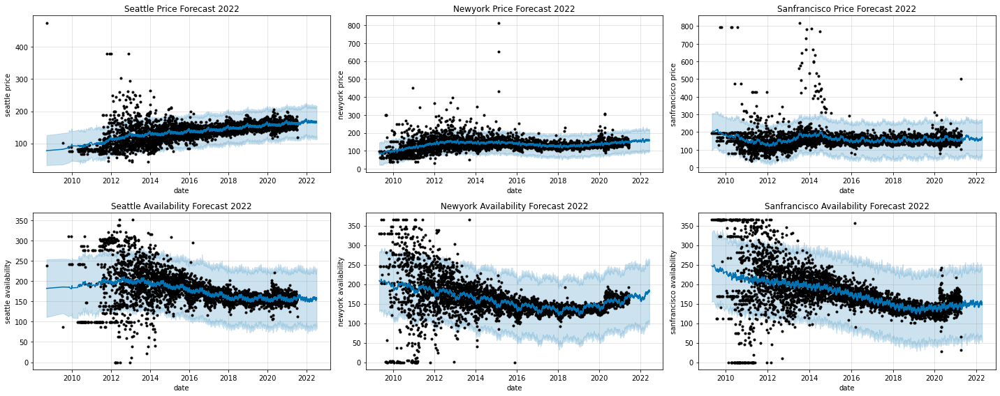

In [77]:
%%time
fig, ax = plt.subplots(2,3, figsize = (20, 8))

# Price forecast plots
sea_forecast_price, sea_model = prepare_timeseries_forecast(df_merge,  'price', 'seattle')
sea_plot_price = sea_model.plot(sea_forecast_price,ax = ax[0,0], xlabel='date', ylabel='seattle price')
_ = ax[0,0].set_title('Seattle Price Forecast 2022')

new_forecast_price, new_model = prepare_timeseries_forecast(df_merge,  'price', 'newyork')
new_plot_price = new_model.plot(new_forecast_price, ax = ax[0,1], xlabel='date', ylabel='newyork price')
_ = ax[0,1].set_title('Newyork Price Forecast 2022')

san_forecast_price, san_model = prepare_timeseries_forecast(df_merge,  'price', 'sanfrancisco')
san_plot_price = san_model.plot(san_forecast_price, ax = ax[0,2], xlabel='date', ylabel='sanfrancisco price')
_ = ax[0,2].set_title('Sanfrancisco Price Forecast 2022')

# Availability forecast plots:
sea_forecast_availability, sea_model_ = prepare_timeseries_forecast(df_merge,  'availability_365', 'seattle')
sea_plot_availability = sea_model_.plot(sea_forecast_availability,ax = ax[1,0], xlabel='date', ylabel='seattle availability')
_ = ax[1,0].set_title('Seattle Availability Forecast 2022')

new_forecast_availability, new_model_ = prepare_timeseries_forecast(df_merge,  'availability_365', 'newyork')
new_plot_availability = new_model_.plot(new_forecast_availability, ax = ax[1,1], xlabel='date', ylabel='newyork availability')
_ = ax[1,1].set_title('Newyork Availability Forecast 2022')

san_forecast_availability, san_model_ = prepare_timeseries_forecast(df_merge,  'availability_365', 'sanfrancisco')
san_plot_availability = san_model_.plot(san_forecast_availability, ax = ax[1,2], xlabel='date', ylabel='sanfrancisco availability')
_ = ax[1,2].set_title('Sanfrancisco Availability Forecast 2022')



In [78]:
# Function to plot time series components:
def plot_timeseries_components(df, col, location):
    forecast, model = prepare_timeseries_forecast(df, col, location)
    _ = model.plot_components(sea_forecast_price, figsize=(8,5))

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


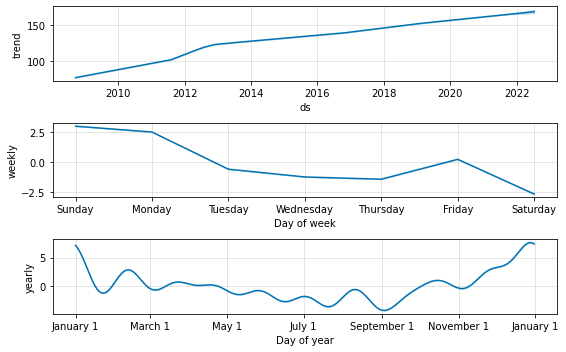

In [79]:
plot_timeseries_components(df_merge, 'price', 'seattle')

#### 7. Plot showing average forecasted price & availability by city

In [80]:
# Forecast Price
sea_forecast = (alt.Chart(sea_forecast_price[['ds','yhat']][sea_forecast_price['ds']>='2021-7'])
                .mark_bar()
                .encode(y= alt.Y('yearmonth(ds):T'),
                        x= alt.X('year(ds):T', title='Forecast Year'),
                        color = alt.Color('yhat:Q', scale=alt.Scale(scheme='greys'), legend=alt.Legend(title = "Forecast")),
                        tooltip=['yearmonth(ds)', 'yhat:Q'], text= 'yhat:Q')
                .properties(width = 100, title= 'Price Forecast Seattle'))



new_forecast = (alt.Chart(new_forecast_price[['ds','yhat']][new_forecast_price['ds']>='2021-7'])
                .mark_bar()
                .encode(y= alt.Y('yearmonth(ds):T'),
                        x= alt.X('year(ds):T', title='Forecast Year'),
                        color = alt.Color('yhat:Q', scale=alt.Scale(scheme='greys'), legend=alt.Legend(title = "Forecast")),
                        tooltip=['yearmonth(ds)', 'yhat:Q'])
                .properties(width = 100, title= 'Price Forecast Newyork'))

san_forecast = (alt.Chart(san_forecast_price[['ds','yhat']][san_forecast_price['ds']>='2021-7'])
                .mark_bar()
                .encode(y= alt.Y('yearmonth(ds):T'),
                        x= alt.X('year(ds):T', title='Forecast Year'), 
                        color = alt.Color('yhat:Q', scale=alt.Scale(scheme='greys'), legend=alt.Legend(title = "Forecast")),
                        tooltip=['yearmonth(ds)', 'yhat:Q'])
                .properties(width = 100, title= 'Price Forecast Sanfrancisco'))

# Availability: 
sea_forecast_ = (alt.Chart(sea_forecast_availability[['ds','yhat']][sea_forecast_availability['ds']>='2021-7'])
                 .mark_bar()
                 .encode(y= alt.Y('yearmonth(ds):T'),
                         x= alt.X('year(ds):T', title='Forecast Year'),
                         color = alt.Color('yhat:Q', scale=alt.Scale(scheme='blues'), legend=alt.Legend(title = "Forecast")),
                         tooltip=['yearmonth(ds)', 'yhat:Q'])
                 .properties(width = 100, title= 'Availability Forecast Seattle'))

new_forecast_ = (alt.Chart(new_forecast_availability[['ds','yhat']][new_forecast_availability['ds']>='2021-7'])
                 .mark_bar()
                 .encode(y= alt.Y('yearmonth(ds):T'),
                         x= alt.X('year(ds):T', title='Forecast Year'),
                         color = alt.Color('yhat:Q', scale=alt.Scale(scheme='reds'), legend=alt.Legend(title = "Forecast")),
                         tooltip=['yearmonth(ds)', 'yhat:Q'])
                 .properties(width = 100, title= 'Availability Forecast Newyork'))

san_forecast_ = (alt.Chart(san_forecast_availability[['ds','yhat']][san_forecast_availability['ds']>='2021-7'])
                 .mark_bar()
                 .encode(y= alt.Y('yearmonth(ds):T'), 
                         x= alt.X('year(ds):T', title='Forecast Year'),
                         color = alt.Color('yhat:Q', scale=alt.Scale(scheme='reds'), legend=alt.Legend(title = "Forecast")),
                         tooltip=['yearmonth(ds)', 'yhat:Q'])
                 .properties(width = 100, title= 'Availability Forecast Sanfrancisco'))

In [81]:
((sea_forecast|new_forecast|san_forecast) & (sea_forecast_|new_forecast_|san_forecast_)).resolve_scale(color='independent')

alt.VConcatChart(...)

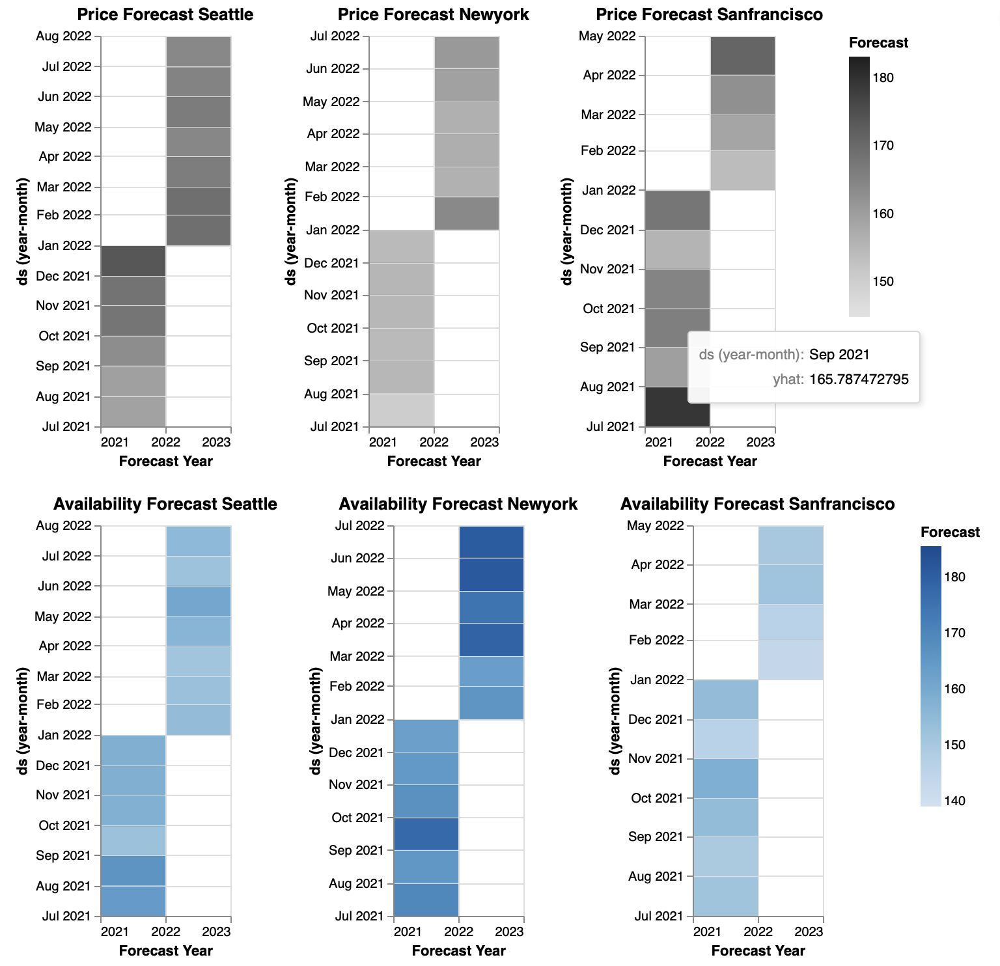

#### Observations: 
1. From above we can see, average forecast of price and availability by city for the next year. 
2. Average price seems to be range bound between $148-$184. 
3. Average Availability seems to be range bound between 140-180 days.
4. What would be the error?

#### 8. Time Series Model Evaluation:

In [82]:
from prophet.diagnostics import cross_validation, performance_metrics

In [83]:
sea_model.name = 'seattle_price_model'
new_model.name = 'newyork_price_model'
san_model.name = 'sanfrancisco_price_model'

sea_model_.name = 'seattle_availability_model'
new_model_.name = 'newyork_availability_model'
san_model_.name = 'sanfrancisco_availability_model'

In [84]:
sea_model.name

'seattle_price_model'

In [85]:
# Using cut off data to train model from 2066-2019 and forecast rates and availability through 2021 until 2022:

# Cut off date:
cutoffs = pd.to_datetime(['2016-12-31', '2017-12-31', '2018-12-31', '2019-12-31'])
def model_performance(): 
    models = [sea_model, new_model, san_model, sea_model_, new_model_, san_model_] 
    
    return pd.concat({model.name:cross_validation(model, cutoffs = cutoffs, horizon = '365 days') for model in models})

In [86]:
# Model Performance 
model_results = model_performance()

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

In [87]:
model_results.head()

ds        yhat  yhat_lower  yhat_upper  \
seattle_price_model 0 2017-01-01  144.969876   76.277195  209.163442   
                    1 2017-01-02  146.066772   82.382697  206.639595   
                    2 2017-01-03  144.412377   82.205420  211.187575   
                    3 2017-01-04  141.834279   79.519025  202.782050   
                    4 2017-01-05  140.034655   73.031829  203.103435   

                                y     cutoff  
seattle_price_model 0  136.700855 2016-12-31  
                    1  152.393939 2016-12-31  
                    2  132.375000 2016-12-31  
                    3  130.227273 2016-12-31  
                    4  121.888889 2016-12-31

In [88]:
# View performance metrix in seattle
performance = performance_metrics(model_results.loc['seattle_availability_model'], rolling_window=0.5)
performance

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,183 days,216.818192,14.724748,11.155654,0.069464,0.055307,0.070972,1.0
1,184 days,217.866875,14.760314,11.174936,0.069576,0.055307,0.071103,1.0
2,185 days,218.865225,14.794094,11.199737,0.069728,0.055307,0.071272,1.0
3,186 days,220.629815,14.853613,11.247085,0.069991,0.055373,0.071571,1.0
4,187 days,219.891176,14.828728,11.227236,0.069838,0.055373,0.071447,1.0
...,...,...,...,...,...,...,...,...
178,361 days,161.396131,12.704178,10.261559,0.063617,0.053558,0.065340,1.0
179,362 days,163.725445,12.795524,10.327513,0.063971,0.054068,0.065733,1.0
180,363 days,163.623508,12.791540,10.319605,0.063924,0.053796,0.065685,1.0
181,364 days,164.243955,12.815770,10.353796,0.064124,0.053983,0.065900,1.0


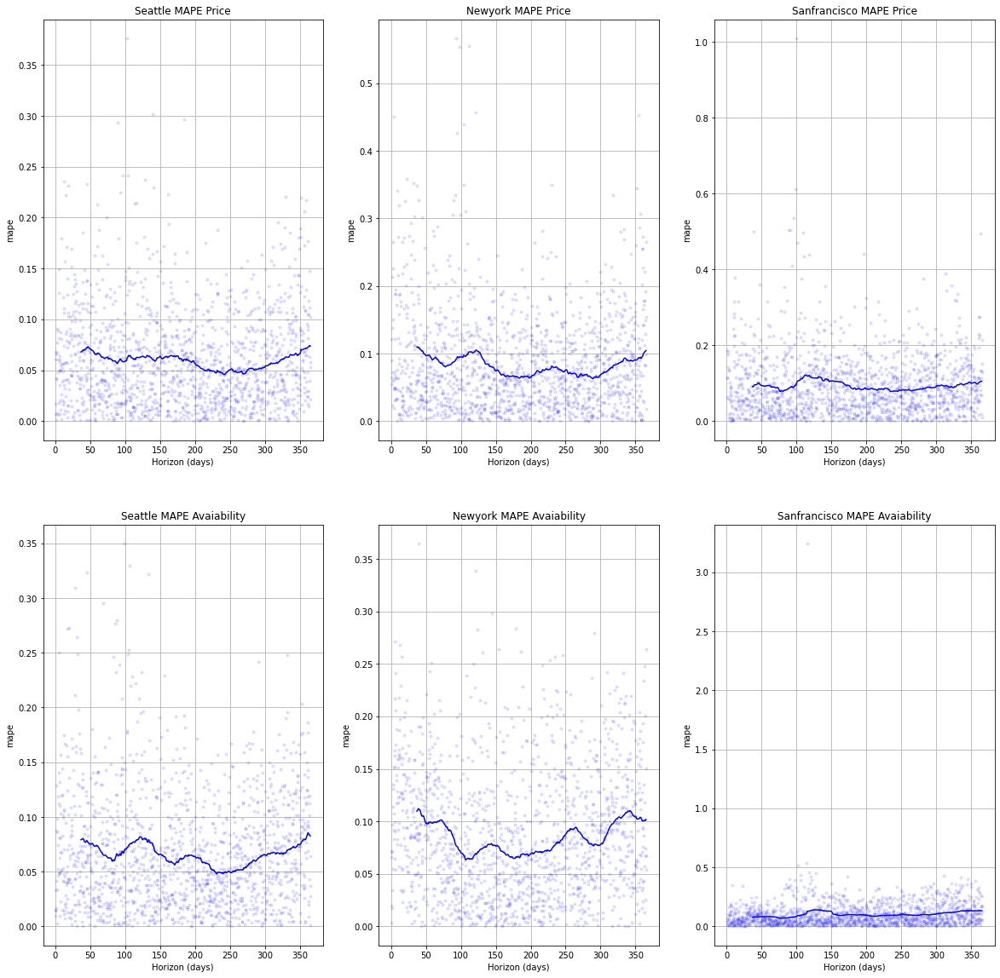

In [89]:
# Plot cross-validation Metrix to see variation in Mean Absolute percentage Error (MAPE) for 365 days in the future: 

from prophet.plot import plot_cross_validation_metric


fig, ax = plt.subplots(2,3, figsize = (20,20))
# Rmse Price model evaluation 
_ = plot_cross_validation_metric(model_results.loc['seattle_price_model'], metric='mape', ax = ax[0,0], rolling_window= 0.1)
_ = ax[0,0].set_title('Seattle MAPE Price')
_ = plot_cross_validation_metric(model_results.loc['newyork_price_model'], metric='mape', ax = ax[0,1])
_ = ax[0,1].set_title('Newyork MAPE Price')
_ = plot_cross_validation_metric(model_results.loc['sanfrancisco_price_model'], metric='mape', ax = ax[0,2])
_ = ax[0,2].set_title('Sanfrancisco MAPE Price')

# Rmse Availability model evaluation 
_ = plot_cross_validation_metric(model_results.loc['seattle_availability_model'], metric='mape', ax= ax[1,0])
_ = ax[1,0].set_title('Seattle MAPE Avaiability')
_ = plot_cross_validation_metric(model_results.loc['newyork_availability_model'], metric='mape', ax= ax[1,1])
_ = ax[1,1].set_title('Newyork MAPE Avaiability')
_ = plot_cross_validation_metric(model_results.loc['sanfrancisco_availability_model'], metric='mape', ax= ax[1,2])
_ = ax[1,2].set_title('Sanfrancisco MAPE Avaiability')

#### Observations: 
1. Using cut off helped reduce MAPE(Mean Absolute Percentage Error).
2. MAPE is calculated on 30 days rolling window for the next 365 days.
3. MAPE for both price and availability for San Francisco is lowest compared to Seattle and New York

#### Potential Scope of Future Study:
1. Use predictions from regression model as an input to build a time series forecast. Evaluate, if it further optimizes results by incorporating feature importance from regression model in time series results, and by how much? (in-progress)
2. Run statistical analysis to test if Air BnB's incentive programs (customer discounts, service improvements, referral incentives) will result in increased revenue potential for the business, and by how much over the next year? (to be started)